In [1]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go

In [2]:
import warnings
warnings.filterwarnings('ignore')

In [3]:
df = pd.read_csv('covid_affect.csv')

In [4]:
df.head()

,age,gender,occupation,line_of_work,time_bp,time_dp,travel_time,easeof_online,home_env,prod_inc,...,fam_connect,relaxed,self_time,like_hw,dislike_hw,prefer,certaindays_hw,Unnamed: 19,time_bp.1,travel+work
0,19-25,Male,Student in College,NaN,7,5,0.5,3,3,0.0,...,1.0,-0.5,-0.5,100,1,Complete Physical Attendance,Yes,NaN,7,NaN
1,Dec-18,Male,Student in School,NaN,7,11,0.5,4,2,-0.5,...,1.0,1.0,1.0,1111,1110,Complete Physical Attendance,No,NaN,7,NaN
2,19-25,Male,Student in College,NaN,7,7,1.5,2,2,1.0,...,0.5,0.5,0.5,1100,111,Complete Physical Attendance,Yes,NaN,7,NaN
3,19-25,Male,Student in College,NaN,7,7,1.5,3,1,0.0,...,0.0,-1.0,-0.5,100,1111,Complete Physical Attendance,Yes,NaN,7,NaN
4,19-25,Female,Student in College,NaN,7,7,1.5,2,2,0.0,...,0.0,0.5,0.0,1010,1000,Complete Physical Attendance,Yes,NaN,7,NaN


In [5]:
df.tail()

,age,gender,occupation,line_of_work,time_bp,time_dp,travel_time,easeof_online,home_env,prod_inc,...,fam_connect,relaxed,self_time,like_hw,dislike_hw,prefer,certaindays_hw,Unnamed: 19,time_bp.1,travel+work
1170,40-50,Female,Entrepreneur,NaN,9,9,0.5,2,1,0.5,...,0.5,0.0,0.0,10,1,Complete Physical Attendance,Yes,NaN,9,NaN
1171,26-32,Female,Homemaker,NaN,5,12,0.5,3,5,-0.5,...,0.0,-0.5,-0.5,100,111,Complete Physical Attendance,Maybe,NaN,5,NaN
1172,26-32,Male,Working Professional,Engineering,9,11,0.5,3,2,0.5,...,0.5,0.0,0.0,1111,110,Complete Physical Attendance,Maybe,NaN,9,NaN
1173,26-32,Male,Working Professional,Engineering,11,12,1.5,2,2,0.0,...,-1.0,0.0,-0.5,1111,1100,Complete Physical Attendance,Yes,NaN,11,NaN
1174,40-50,Male,Working Professional,Engineering,5,5,0.5,2,2,0.5,...,0.5,0.5,0.5,1100,101,Work/study from home,Yes,NaN,5,NaN


In [6]:
df.shape

(1175, 22)

In [7]:
df.columns

Index(['age', 'gender', 'occupation', 'line_of_work', 'time_bp', 'time_dp',
       'travel_time', 'easeof_online', 'home_env', 'prod_inc', 'sleep_bal',
       'new_skill', 'fam_connect', 'relaxed', 'self_time', 'like_hw',
       'dislike_hw', 'prefer', 'certaindays_hw', 'Unnamed: 19', 'time_bp.1',
       'travel+work'],
      dtype='object')

In [8]:
df.duplicated().sum()

762

In [9]:
df.isnull().sum()

age                  0
gender               0
occupation           0
line_of_work       696
time_bp              0
time_dp              0
travel_time          0
easeof_online        0
home_env             0
prod_inc             0
sleep_bal            0
new_skill            0
fam_connect          0
relaxed              0
self_time            0
like_hw              0
dislike_hw           0
prefer               0
certaindays_hw       0
Unnamed: 19       1175
time_bp.1            0
travel+work       1175
dtype: int64

In [10]:
df = df.drop(['line_of_work', 'Unnamed: 19', 'travel+work'], axis = 1)

In [11]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1175 entries, 0 to 1174
Data columns (total 19 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   age             1175 non-null   object 
 1   gender          1175 non-null   object 
 2   occupation      1175 non-null   object 
 3   time_bp         1175 non-null   int64  
 4   time_dp         1175 non-null   int64  
 5   travel_time     1175 non-null   float64
 6   easeof_online   1175 non-null   int64  
 7   home_env        1175 non-null   int64  
 8   prod_inc        1175 non-null   float64
 9   sleep_bal       1175 non-null   float64
 10  new_skill       1175 non-null   float64
 11  fam_connect     1175 non-null   float64
 12  relaxed         1175 non-null   float64
 13  self_time       1175 non-null   float64
 14  like_hw         1175 non-null   int64  
 15  dislike_hw      1175 non-null   int64  
 16  prefer          1175 non-null   object 
 17  certaindays_hw  1175 non-null   o

In [12]:
df.describe()

,time_bp,time_dp,travel_time,easeof_online,home_env,prod_inc,sleep_bal,new_skill,fam_connect,relaxed,self_time,like_hw,dislike_hw,time_bp.1
count,1175.000000,1175.000000,1175.000000,1175.000000,1175.000000,1175.000000,1175.000000,1175.000000,1175.000000,1175.000000,1175.000000,1175.000000,1175.000000,1175.000000
mean,7.415319,7.971915,1.027660,2.533617,2.752340,0.008936,-0.108936,0.146809,0.260426,0.035745,0.082979,734.840851,651.067234,7.415319
std,2.005385,2.657007,0.713314,1.267609,1.235799,0.615083,0.621215,0.643686,0.686825,0.626637,0.541434,468.000935,502.319310,2.005385
min,4.000000,4.000000,0.500000,1.000000,1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,1.000000,1.000000,4.000000
25%,5.000000,5.000000,0.500000,1.000000,2.000000,-0.500000,-0.500000,-0.500000,0.000000,-0.500000,-0.500000,100.000000,101.000000,5.000000
50%,7.000000,9.000000,0.500000,2.000000,3.000000,0.000000,0.000000,0.500000,0.500000,0.000000,0.000000,1001.000000,1000.000000,7.000000
75%,9.000000,9.000000,1.500000,4.000000,4.000000,0.500000,0.500000,0.500000,1.000000,0.500000,0.500000,1100.000000,1101.000000,9.000000
max,12.000000,12.000000,3.000000,5.000000,5.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1111.000000,1111.000000,12.000000


In [13]:
df.nunique()

age                7
gender             3
occupation         8
time_bp            6
time_dp            6
travel_time        4
easeof_online      5
home_env           5
prod_inc           5
sleep_bal          5
new_skill          5
fam_connect        5
relaxed            5
self_time          5
like_hw           15
dislike_hw        15
prefer             2
certaindays_hw     3
time_bp.1          6
dtype: int64

In [14]:
numerical_columns = df.select_dtypes(include=['int64', 'float64']).columns
print("Numerical Columns:",numerical_columns)

object_columns = df.select_dtypes(include=['object']).columns
print("\nObject Columns:",object_columns)

Numerical Columns: Index(['time_bp', 'time_dp', 'travel_time', 'easeof_online', 'home_env',
       'prod_inc', 'sleep_bal', 'new_skill', 'fam_connect', 'relaxed',
       'self_time', 'like_hw', 'dislike_hw', 'time_bp.1'],
      dtype='object')

Object Columns: Index(['age', 'gender', 'occupation', 'prefer', 'certaindays_hw'], dtype='object')


In [15]:
for column in numerical_columns:
    unique_values = df[column].unique()
    print(f"{column}: {unique_values}")

time_bp: [ 7  5  9 11  4 12]
time_dp: [ 5 11  7  4  9 12]
travel_time: [0.5 1.5 2.5 3. ]
easeof_online: [3 4 2 1 5]
home_env: [3 2 1 4 5]
prod_inc: [ 0.  -0.5  1.  -1.   0.5]
sleep_bal: [ 0.   0.5  1.  -1.  -0.5]
new_skill: [ 0.5 -1.   0.   1.  -0.5]
fam_connect: [ 1.   0.5  0.  -0.5 -1. ]
relaxed: [-0.5  1.   0.5 -1.   0. ]
self_time: [-0.5  1.   0.5  0.  -1. ]
like_hw: [ 100 1111 1100 1010  110 1000 1110   10 1001    1 1011   11  101  111
 1101]
dislike_hw: [   1 1110  111 1111 1000 1100 1101  100 1011 1001 1010   10  101   11
  110]
time_bp.1: [ 7  5  9 11  4 12]


In [16]:
for column in object_columns:
    unique_values = df[column].unique()
    print(f"{column}: {unique_values}")

age: ['19-25' 'Dec-18' '33-40' '60+' '26-32' '40-50' '50-60']
gender: ['Male' 'Female' 'Prefer not to say']
occupation: ['Student in College' 'Student in School' 'Working Professional'
 'Entrepreneur' 'Retired/Senior Citizen' 'Homemaker'
 'Currently Out of Work'
 'Medical Professional aiding efforts against COVID-19']
prefer: ['Complete Physical Attendance' 'Work/study from home']
certaindays_hw: ['Yes' 'No' 'Maybe']


In [17]:
for column in numerical_columns:
    value_counts = df[column].value_counts()
    print(column,':') 
    print(value_counts)
    print('\n')

time_bp :
7     412
9     343
5     283
11     53
12     51
4      33
Name: time_bp, dtype: int64


time_dp :
9     326
7     238
5     180
12    169
4     149
11    113
Name: time_dp, dtype: int64


travel_time :
0.5    699
1.5    343
2.5    111
3.0     22
Name: travel_time, dtype: int64


easeof_online :
1    329
2    285
4    249
3    239
5     73
Name: easeof_online, dtype: int64


home_env :
3    327
2    309
1    215
4    200
5    124
Name: home_env, dtype: int64


prod_inc :
 0.5    302
 0.0    295
-0.5    279
-1.0    150
 1.0    149
Name: prod_inc, dtype: int64


sleep_bal :
-0.5    313
 0.5    271
 0.0    270
-1.0    214
 1.0    107
Name: sleep_bal, dtype: int64


new_skill :
 0.5    366
-0.5    249
 1.0    236
 0.0    202
-1.0    122
Name: new_skill, dtype: int64


fam_connect :
 0.5    414
 1.0    326
-1.0    181
 0.0    162
-0.5     92
Name: fam_connect, dtype: int64


relaxed :
 0.0    306
 0.5    274
-0.5    268
 1.0    183
-1.0    144
Name: relaxed, dtype: int64


self_t

In [18]:
for column in object_columns:
    value_counts = df[column].value_counts()
    print(column,':') 
    print(value_counts)
    print('\n')

age :
19-25     345
26-32     261
40-50     181
50-60     170
33-40     102
Dec-18     74
60+        42
Name: age, dtype: int64


gender :
Male                 649
Female               518
Prefer not to say      8
Name: gender, dtype: int64


occupation :
Working Professional                                    479
Student in College                                      358
Entrepreneur                                            119
Homemaker                                                82
Medical Professional aiding efforts against COVID-19     73
Currently Out of Work                                    44
Student in School                                        18
Retired/Senior Citizen                                    2
Name: occupation, dtype: int64


prefer :
Complete Physical Attendance    836
Work/study from home            339
Name: prefer, dtype: int64


certaindays_hw :
Yes      568
No       309
Maybe    298
Name: certaindays_hw, dtype: int64




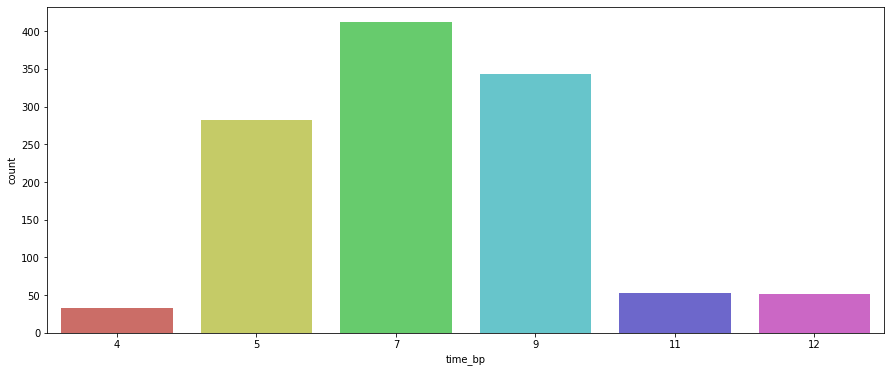

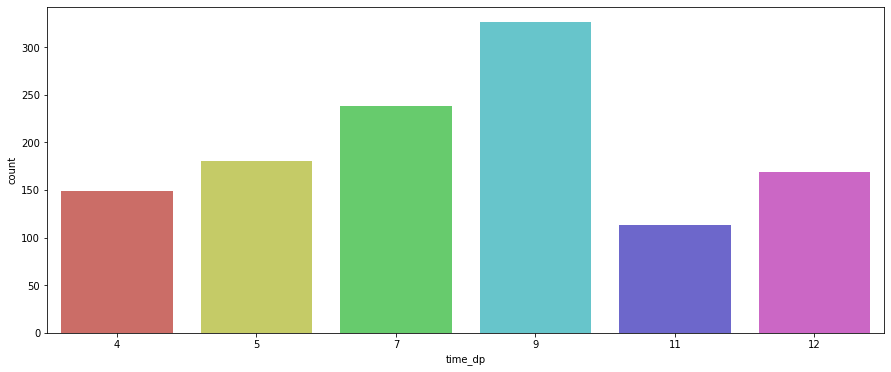

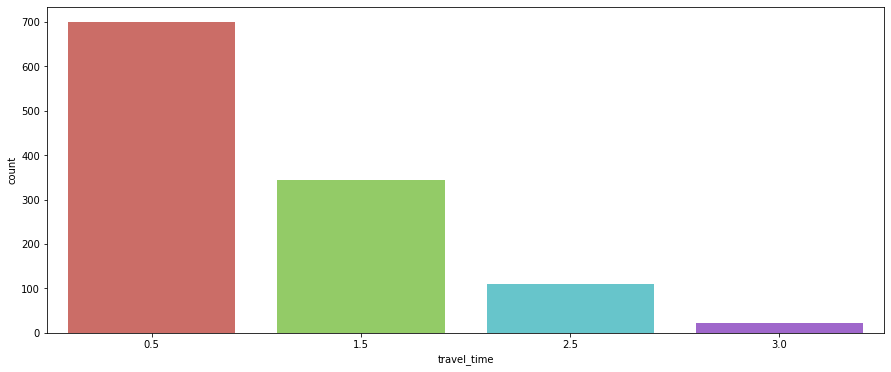

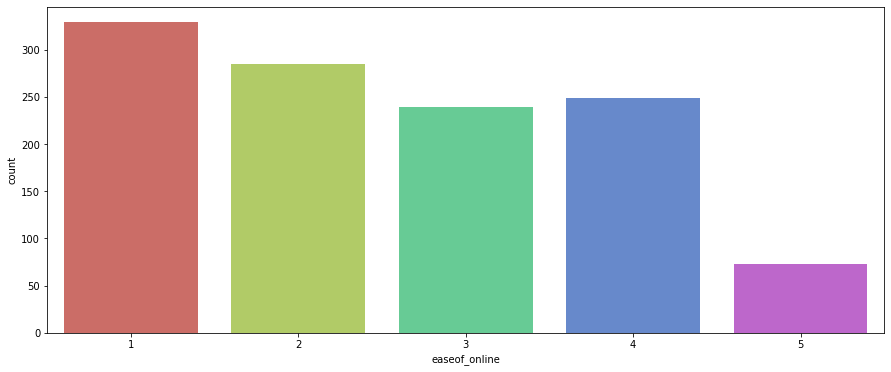

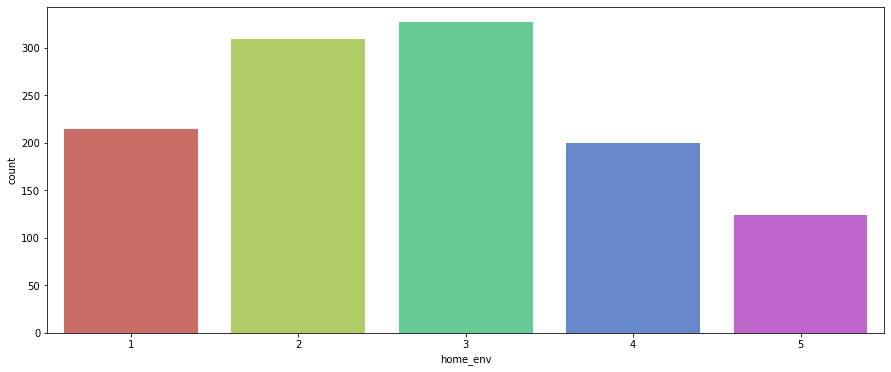

...

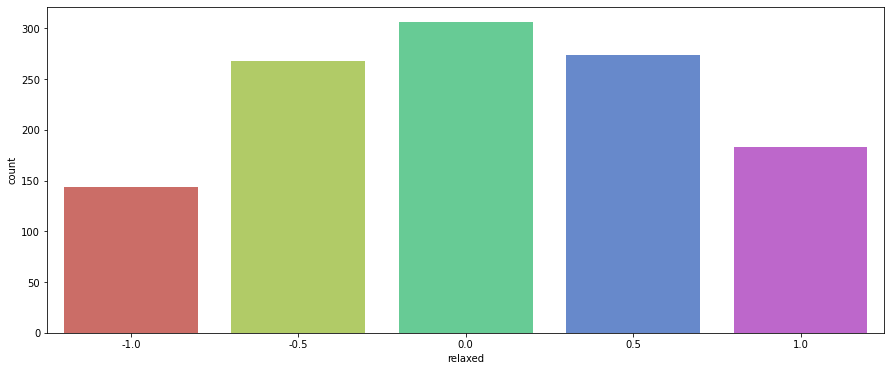

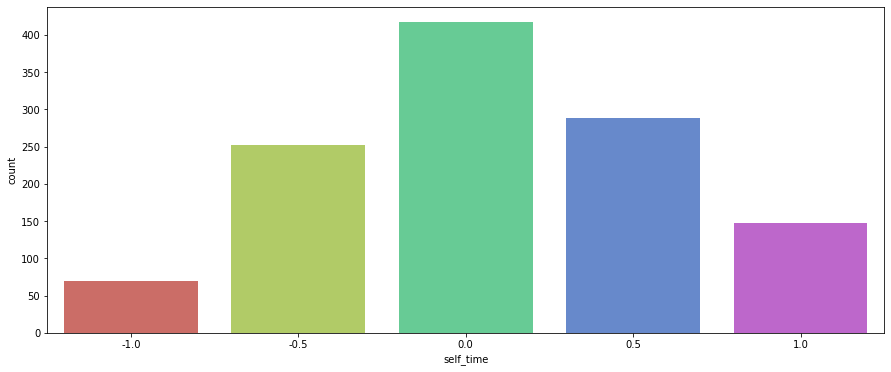

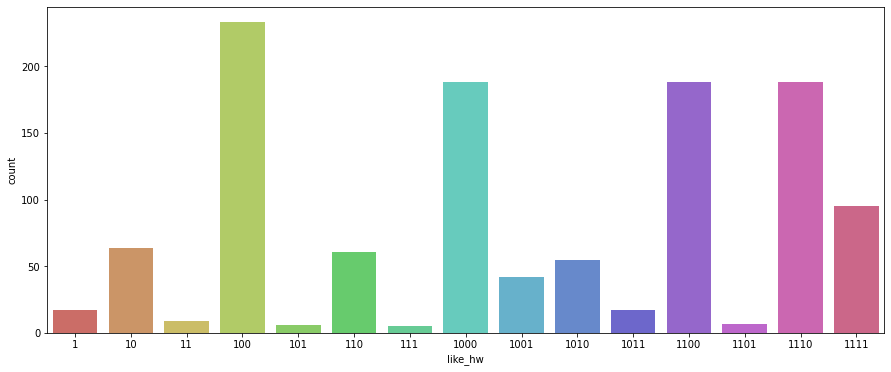

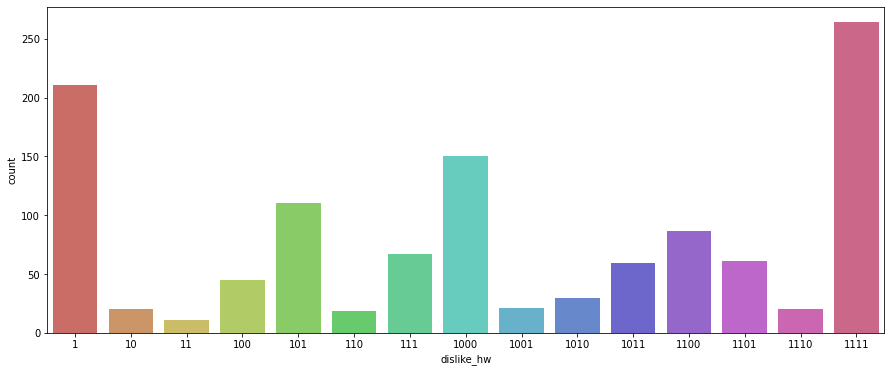

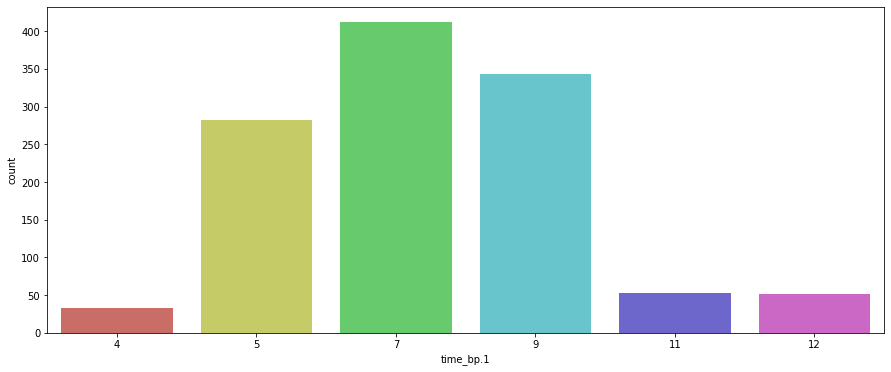

In [19]:
for i in numerical_columns:
    plt.figure(figsize=(15,6))
    sns.countplot(df[i], data = df, palette = 'hls')
    plt.xticks(rotation = 0)
    plt.show()

In [20]:
for i in numerical_columns:
    fig = go.Figure(data=[go.Bar(x=df[i].value_counts().index, y=df[i].value_counts())])
    fig.update_layout(
        title=i,
        xaxis_title=i,
        yaxis_title="Count")
    fig.show()

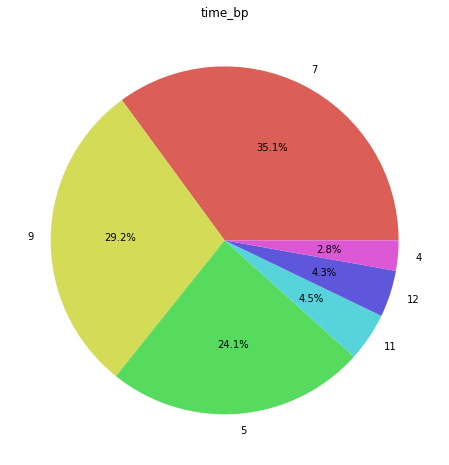

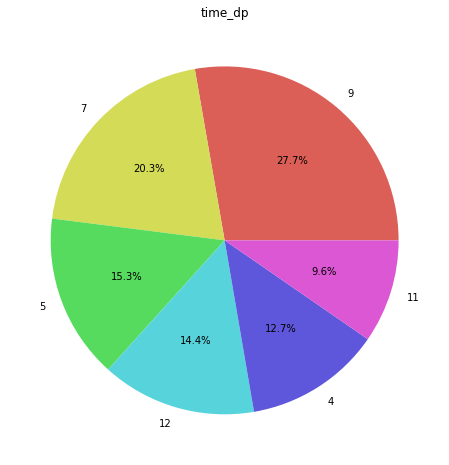

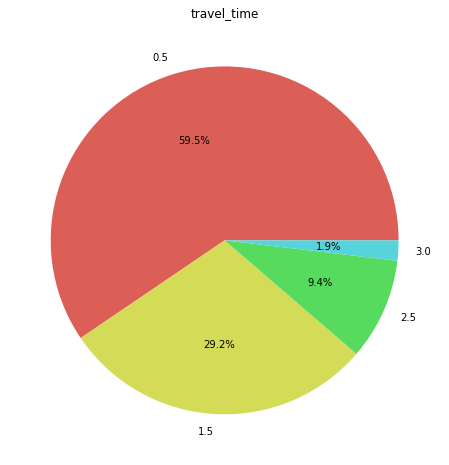

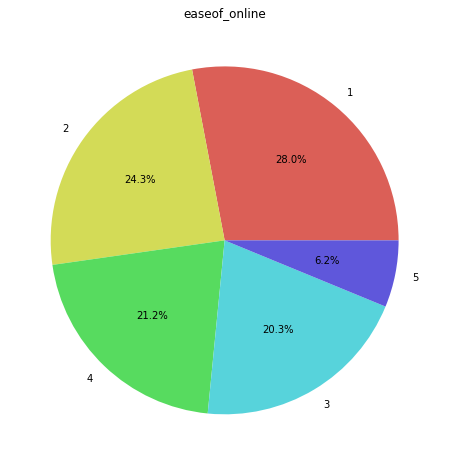

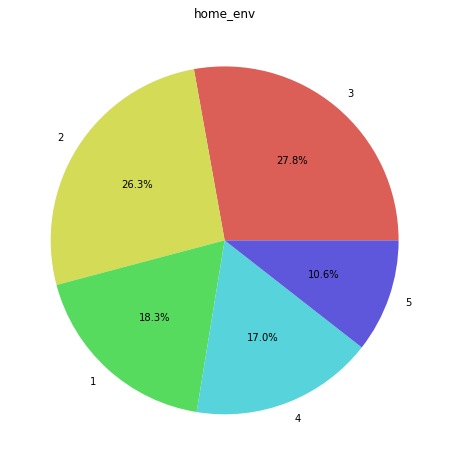

...

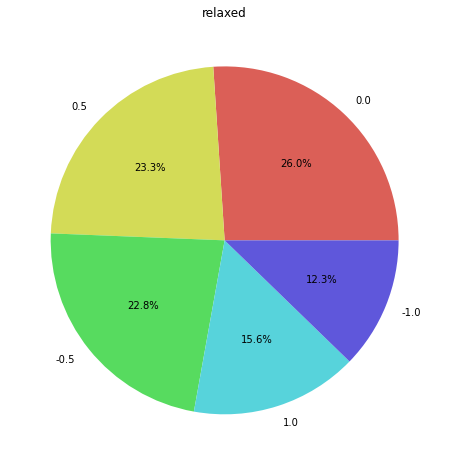

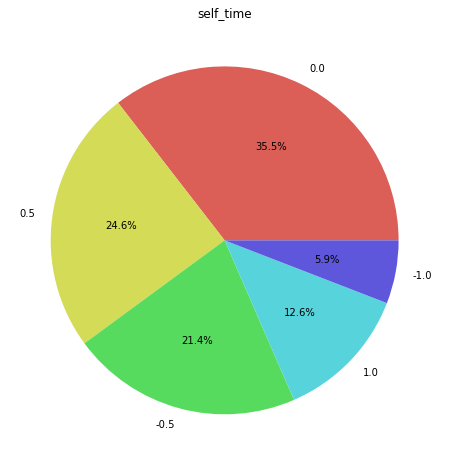

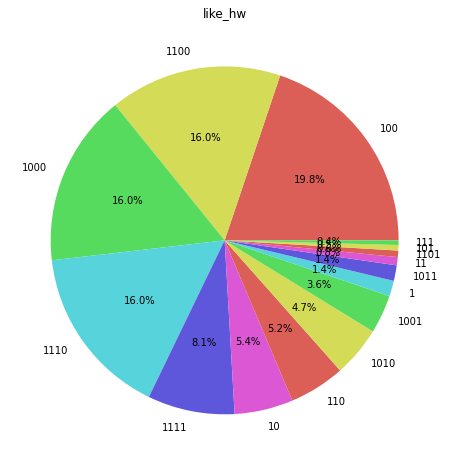

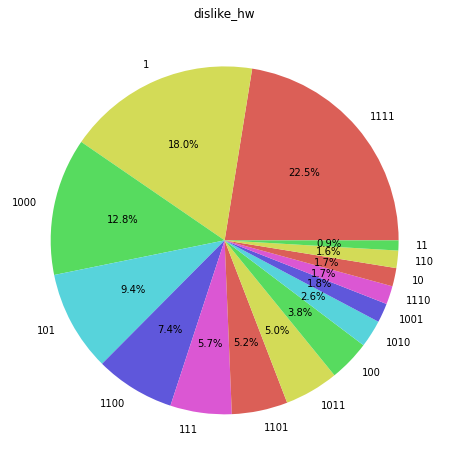

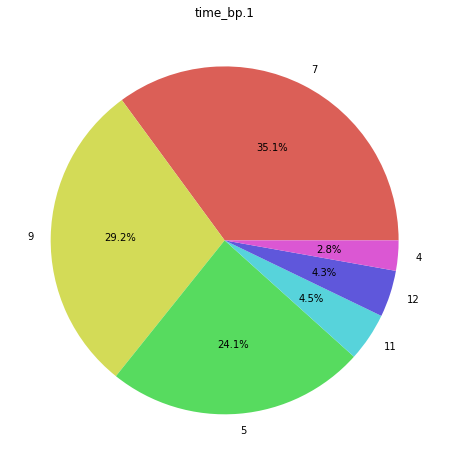

In [21]:
for i in numerical_columns:
    plt.figure(figsize=(20, 8))
    counts = df[i].value_counts()
    plt.pie(counts, labels=counts.index, autopct='%1.1f%%', colors=sns.color_palette('hls'))
    plt.title(i)
    plt.show()

In [22]:
for i in numerical_columns:
    counts = df[i].value_counts()
    fig = go.Figure(data=[go.Pie(labels=counts.index, values=counts)])
    fig.update_layout(title= i)
    fig.show()

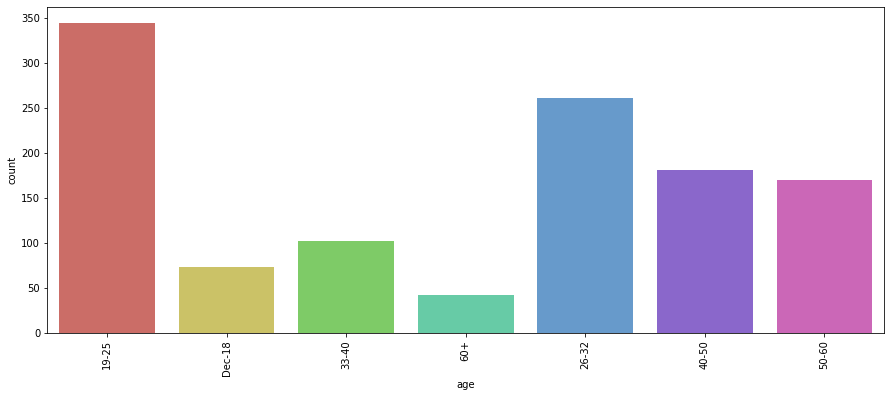

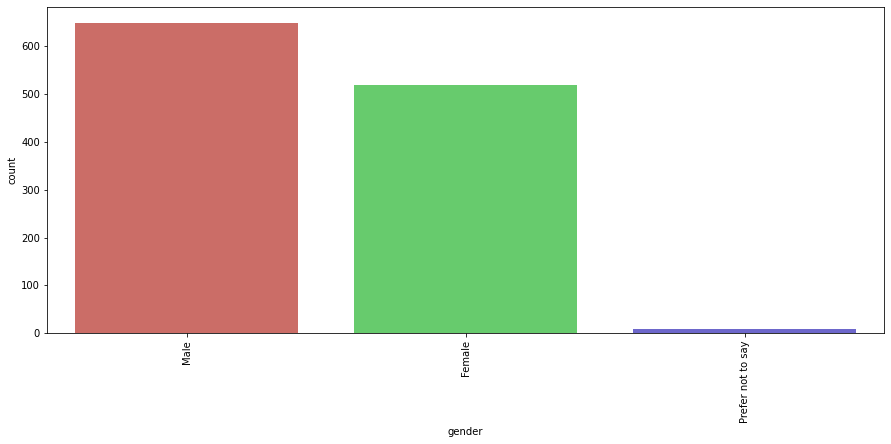

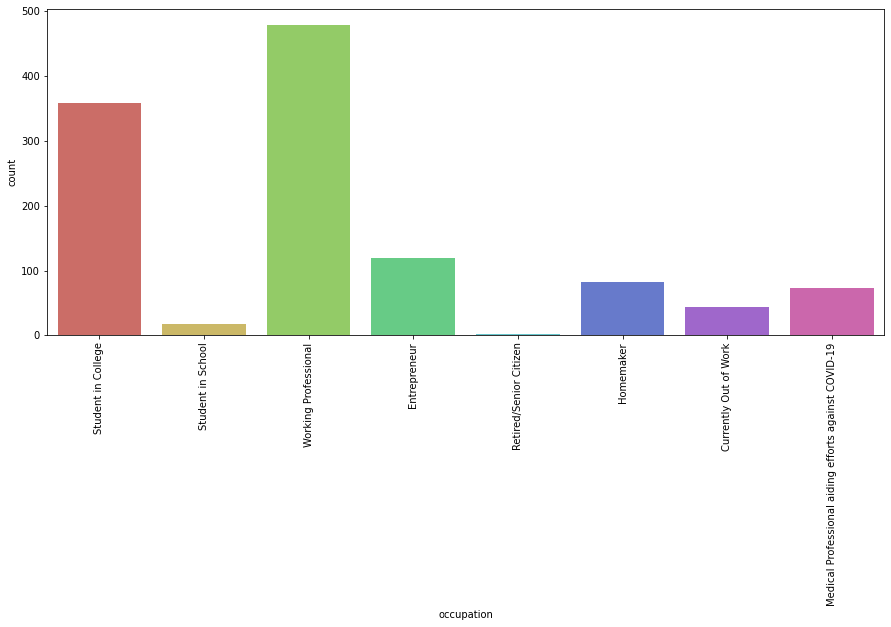

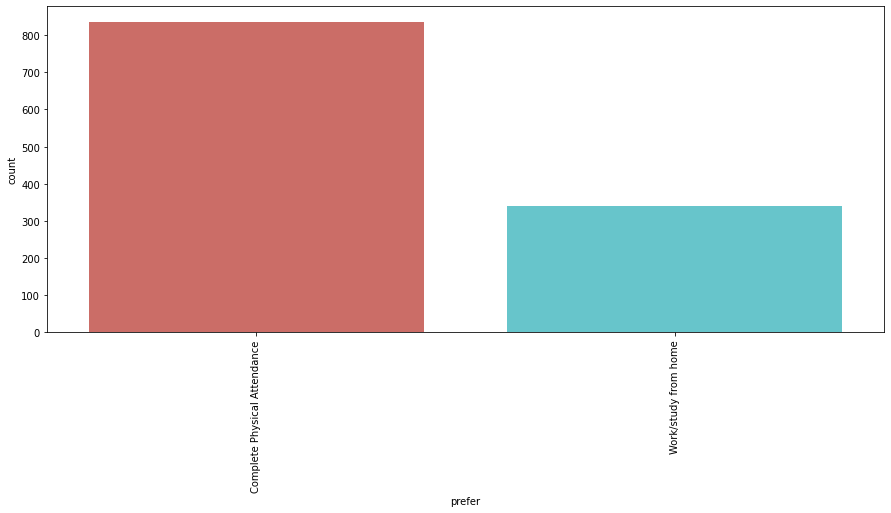

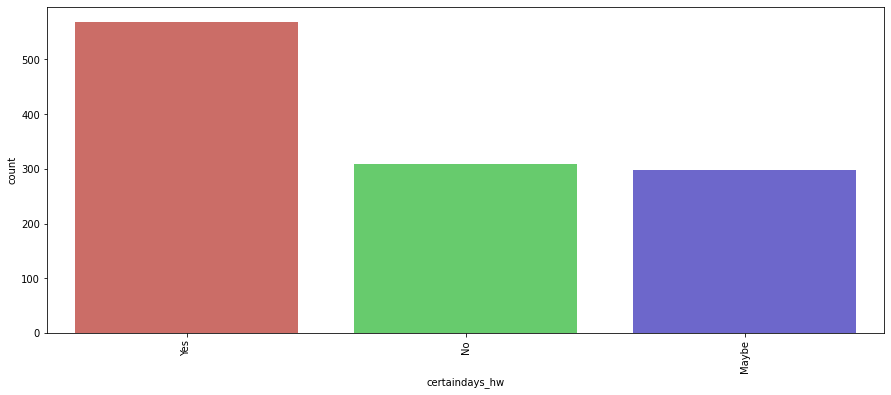

In [23]:
for i in object_columns:
    plt.figure(figsize=(15,6))
    sns.countplot(df[i], data = df, palette = 'hls')
    plt.xticks(rotation = 90)
    plt.show()

In [24]:
for i in object_columns:
    fig = go.Figure(data=[go.Bar(x=df[i].value_counts().index, y=df[i].value_counts())])
    fig.update_layout(
        title= i,
        xaxis_title= i,
        yaxis_title="Count"
    )
    fig.show()

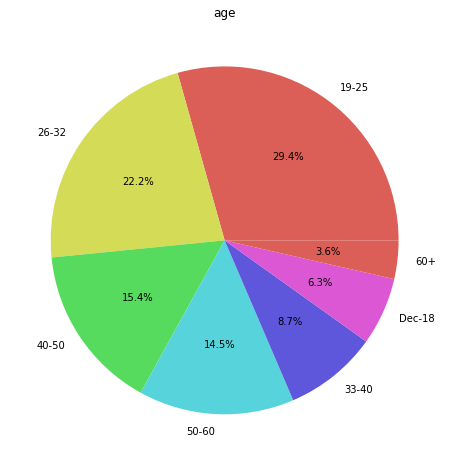

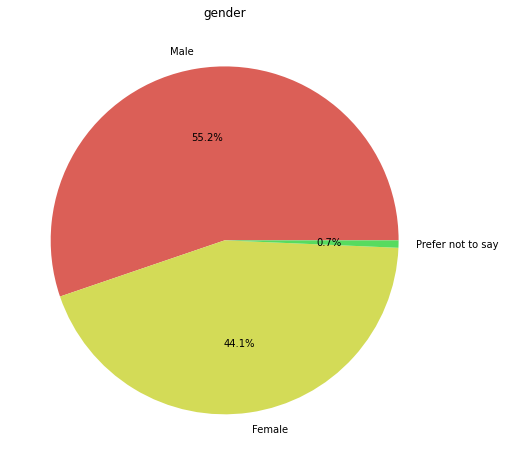

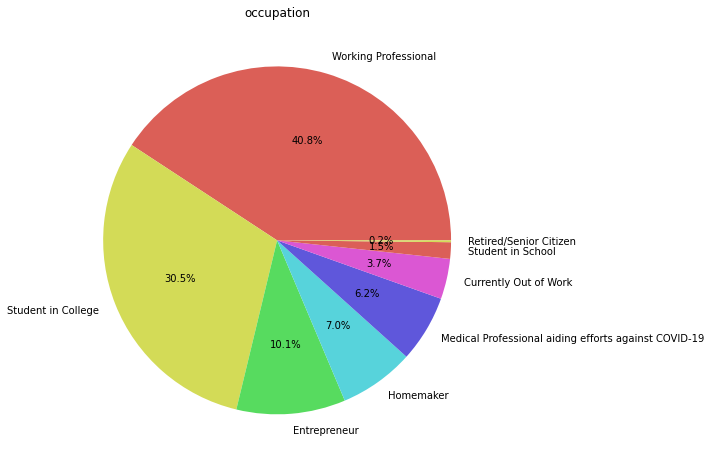

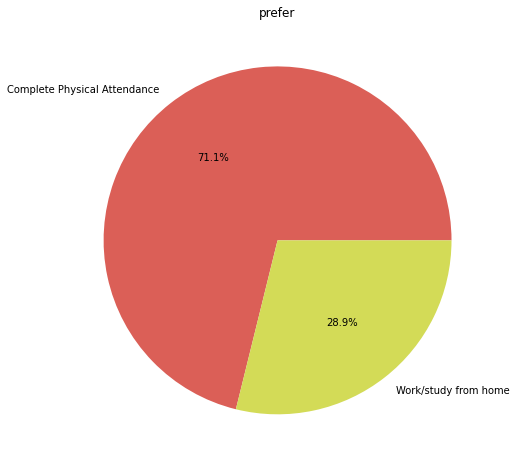

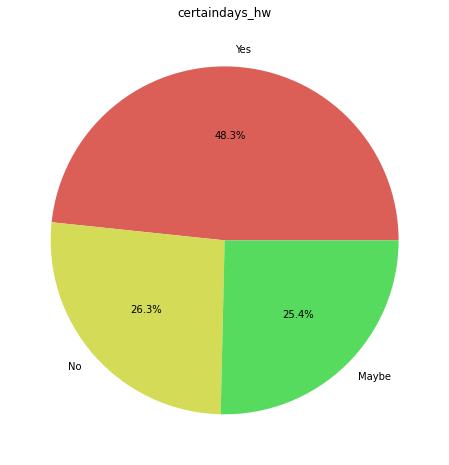

In [25]:
for i in object_columns:
    plt.figure(figsize=(20, 8))
    counts = df[i].value_counts()
    plt.pie(counts, labels=counts.index, autopct='%1.1f%%', colors=sns.color_palette('hls'))
    plt.title(i)
    plt.show()

In [26]:
for i in object_columns:
    counts = df[i].value_counts()
    fig = go.Figure(data=[go.Pie(labels=counts.index, values=counts)])
    fig.update_layout(title= i)
    fig.show()

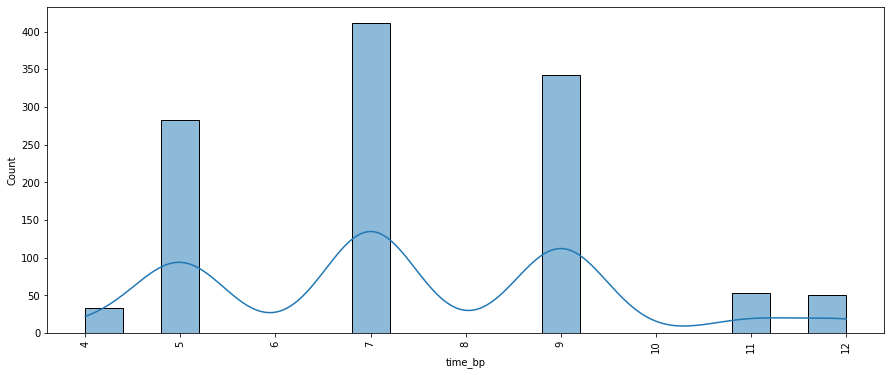

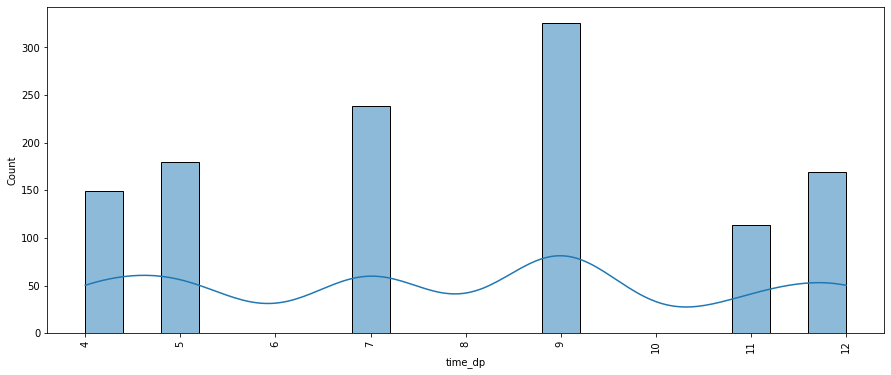

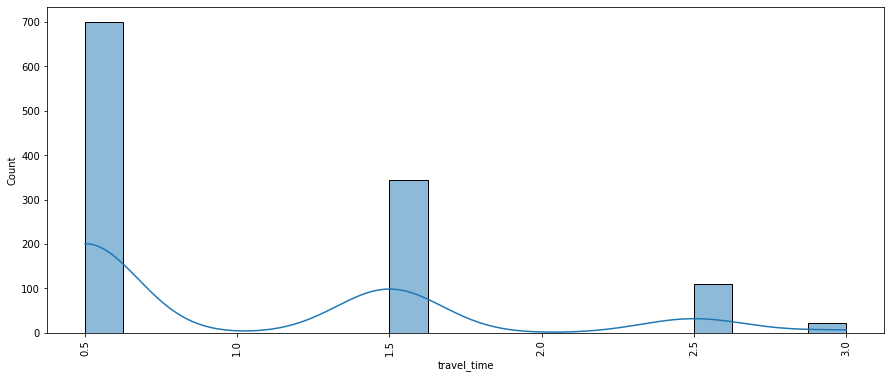

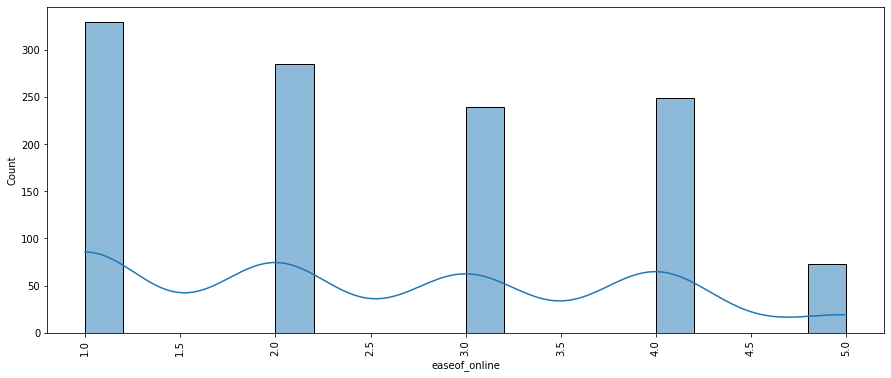

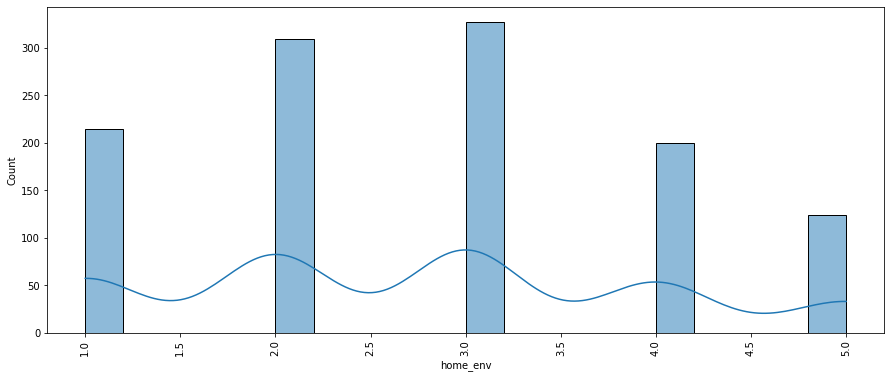

...

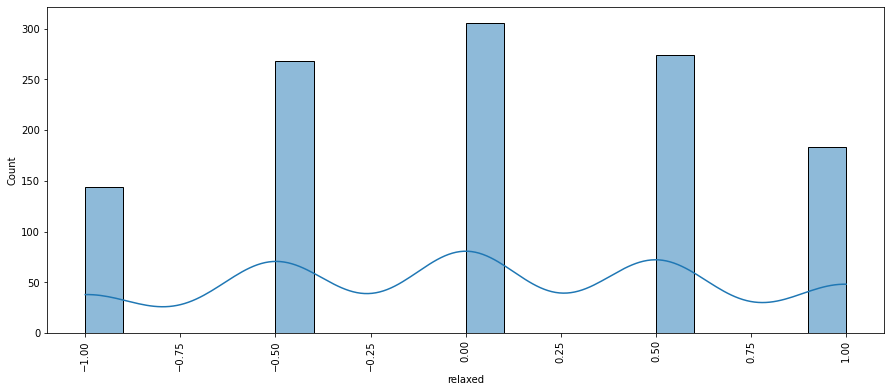

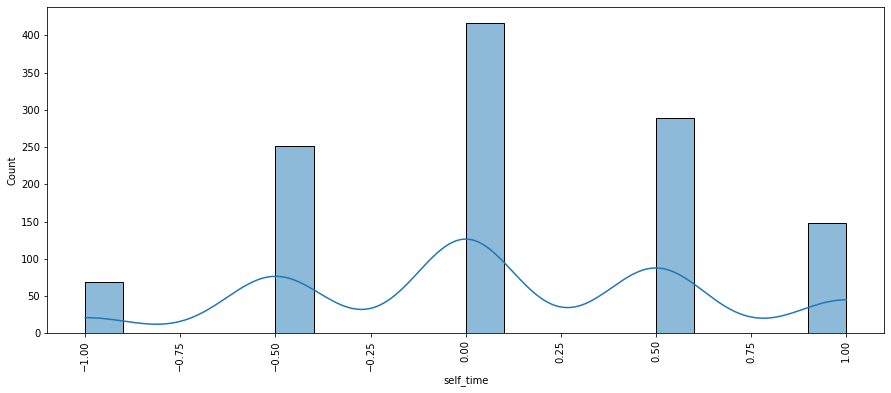

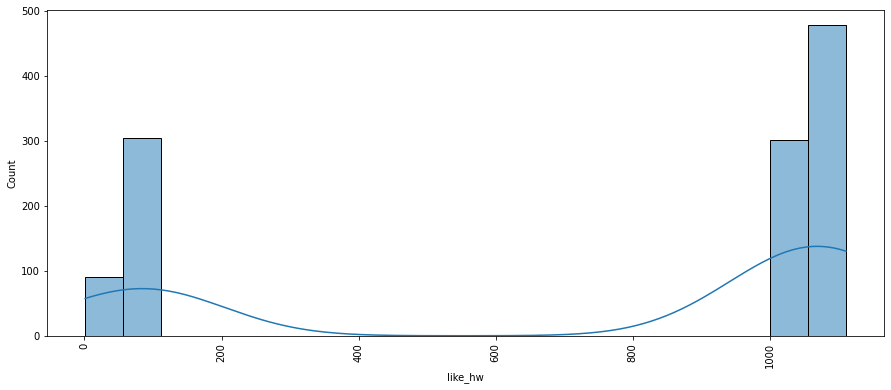

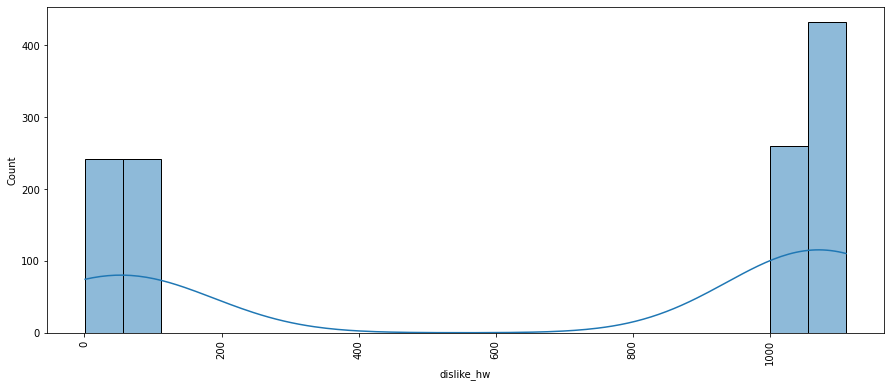

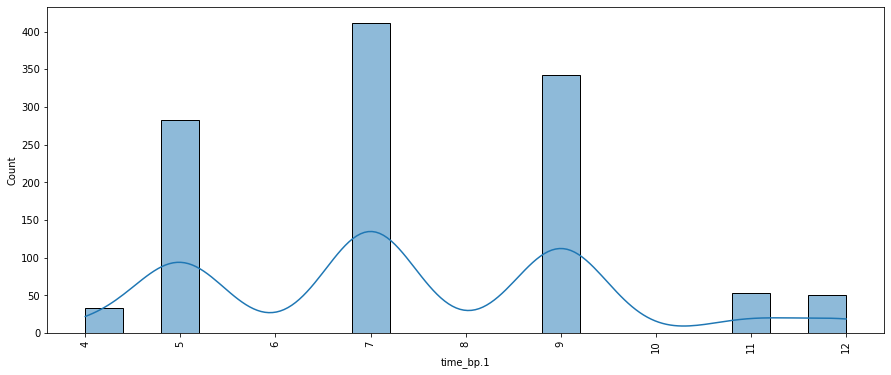

In [27]:
for i in numerical_columns:
    plt.figure(figsize=(15,6))
    sns.histplot(df[i], kde = True, bins = 20, palette = 'hls')
    plt.xticks(rotation = 90)
    plt.show()

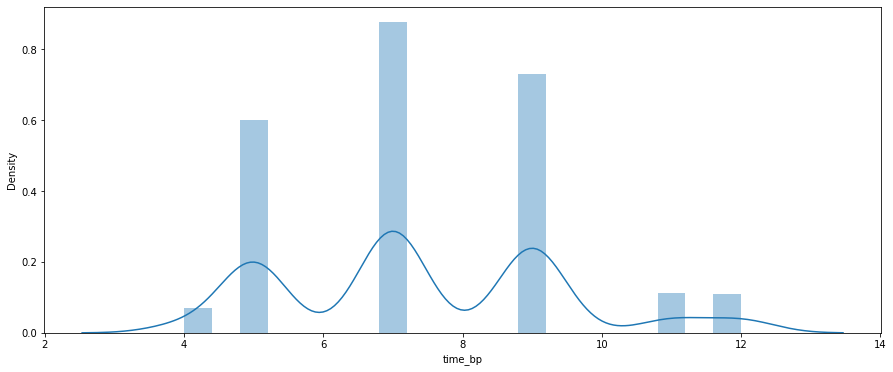

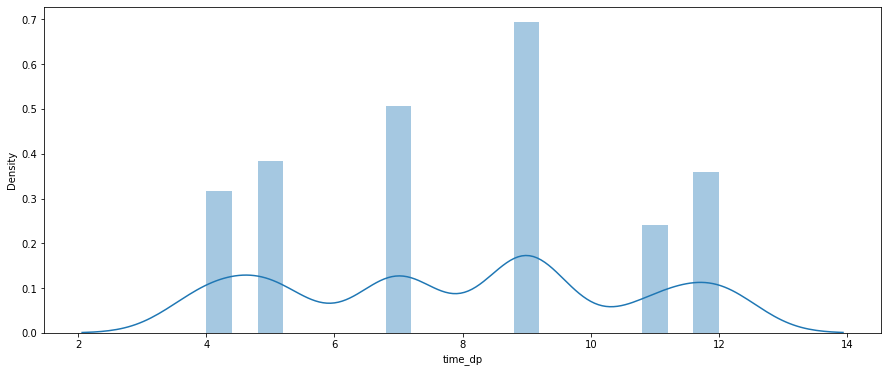

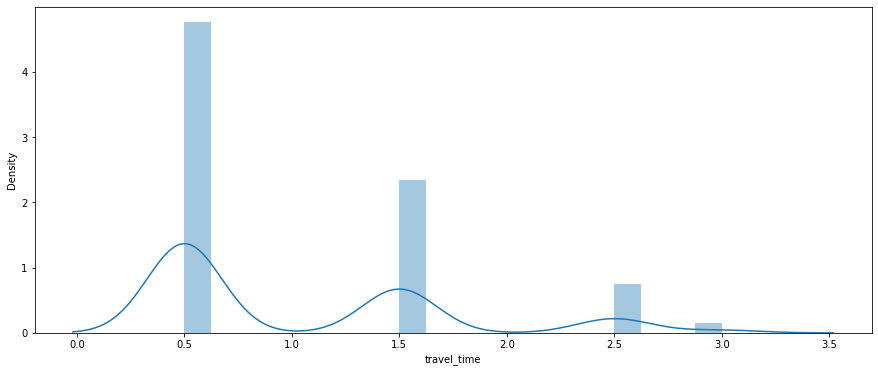

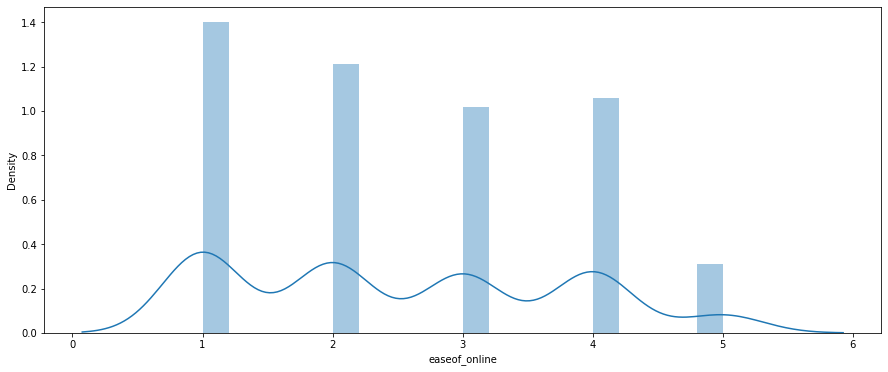

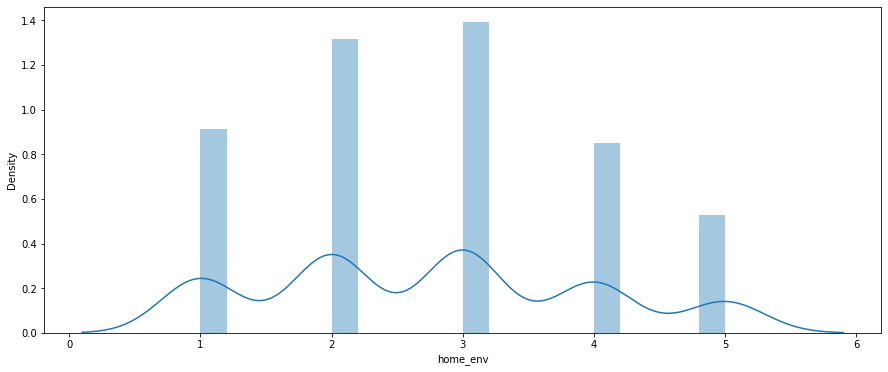

...

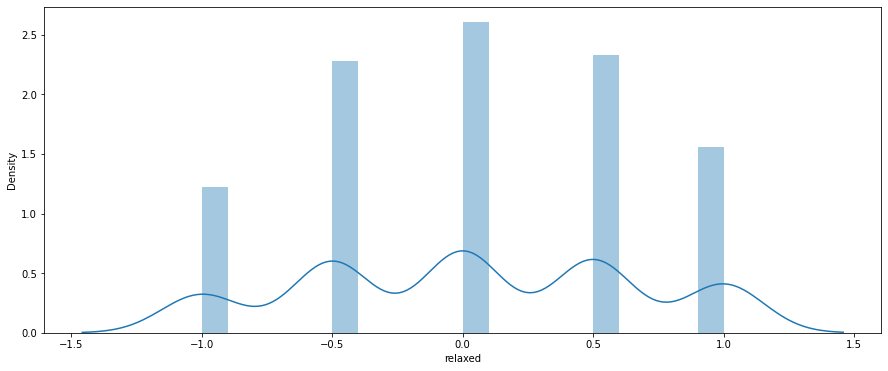

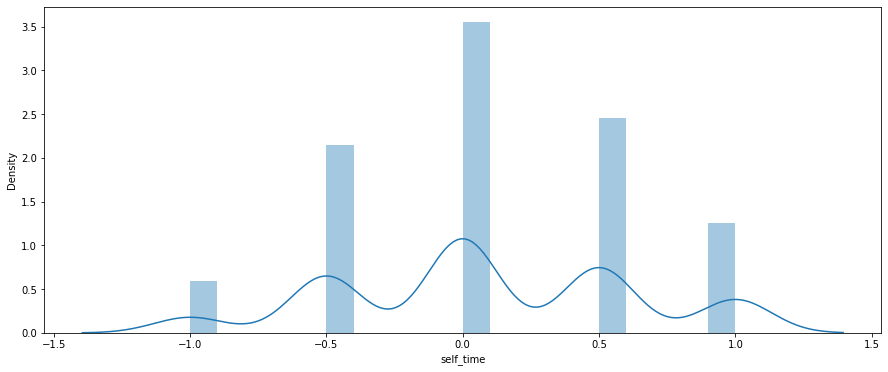

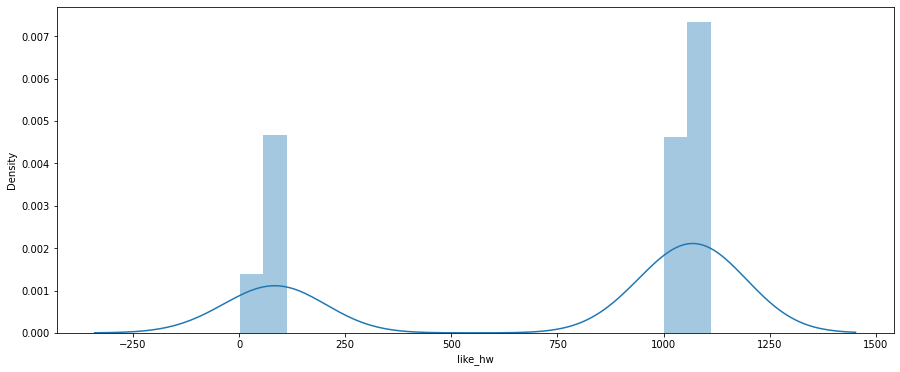

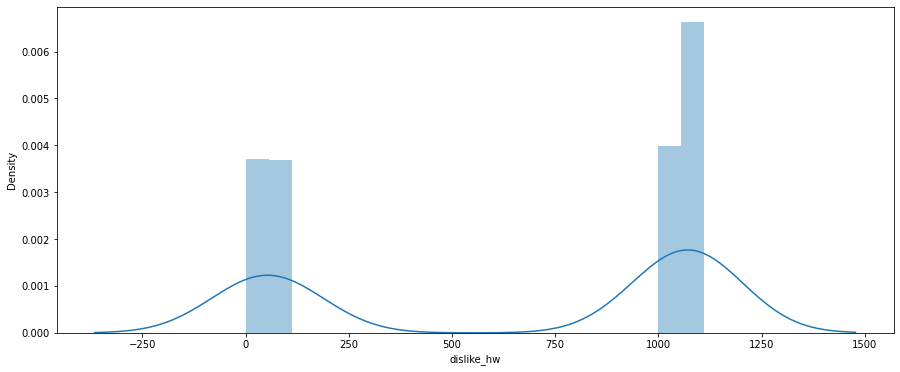

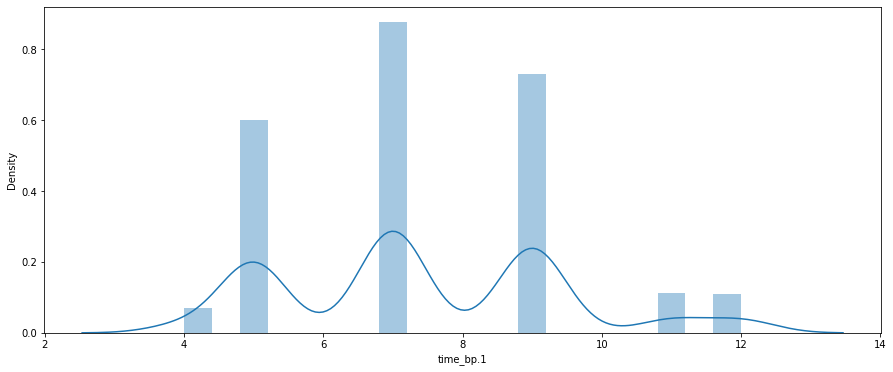

In [28]:
for i in numerical_columns:
    plt.figure(figsize=(15,6))
    sns.distplot(df[i], kde = True, bins = 20)
    plt.xticks(rotation = 0)
    plt.show()

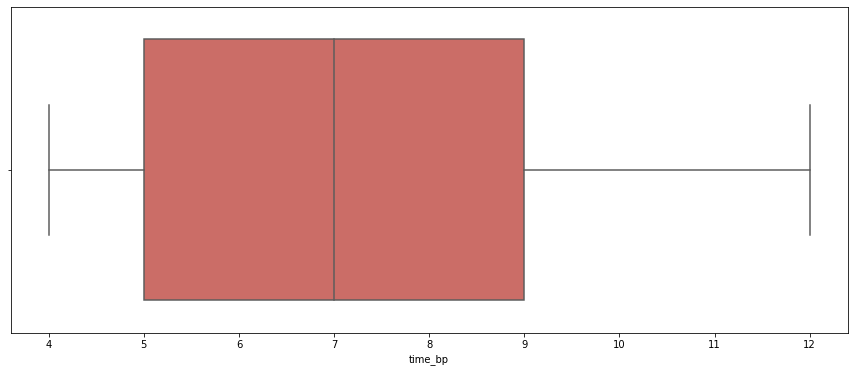

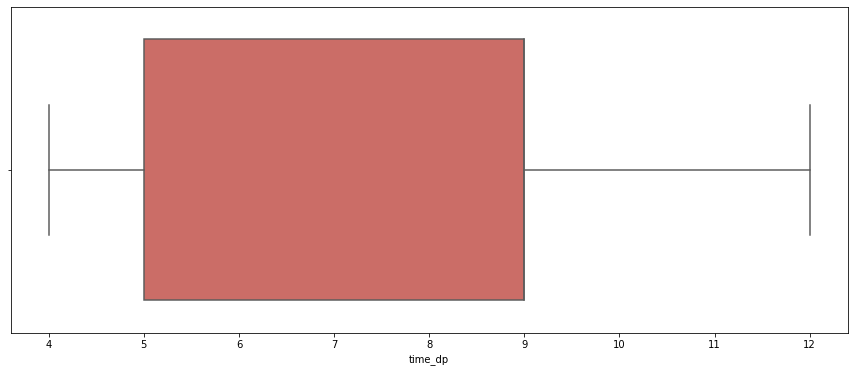

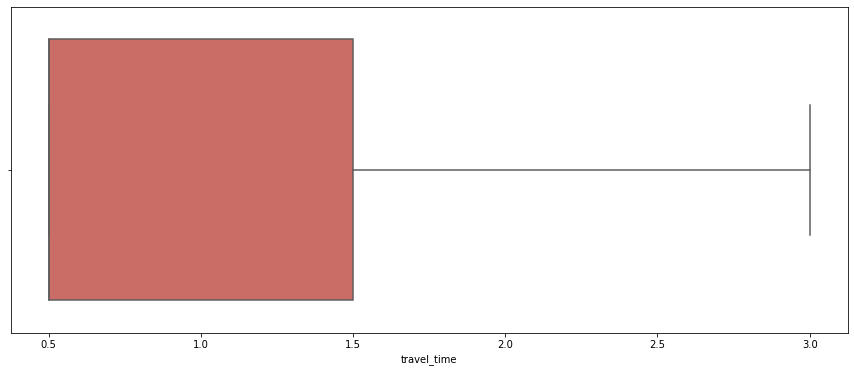

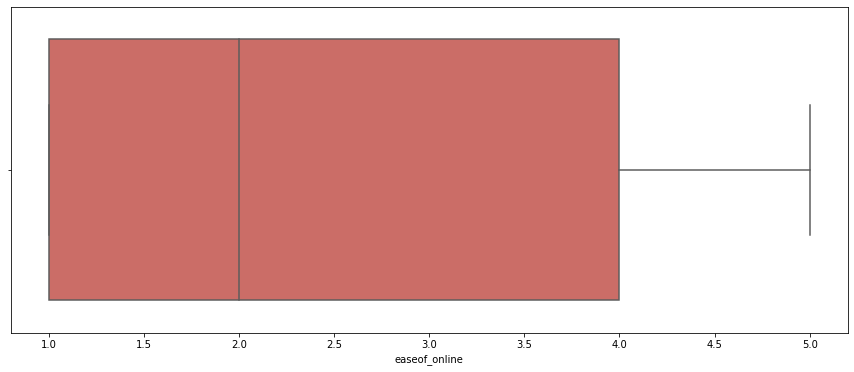

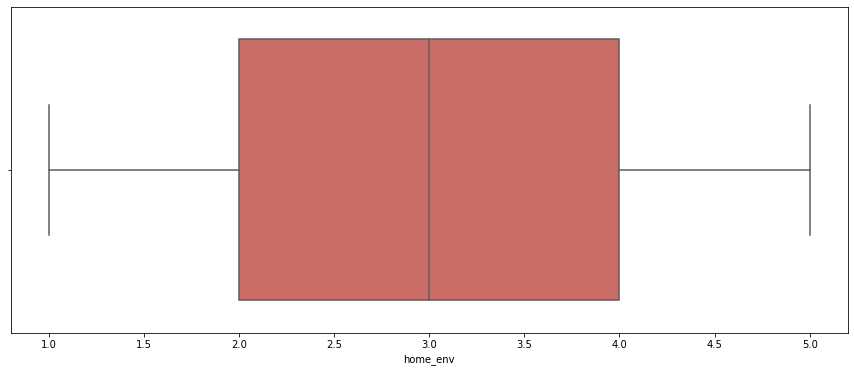

...

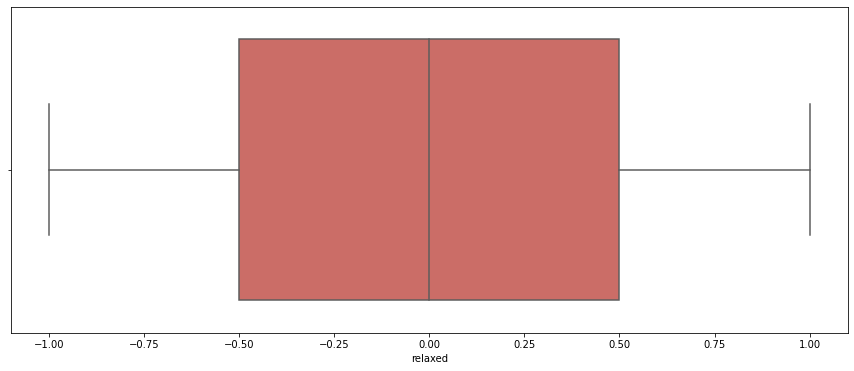

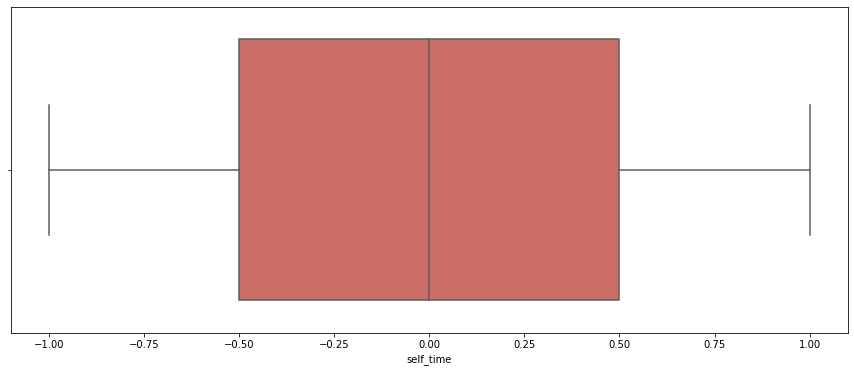

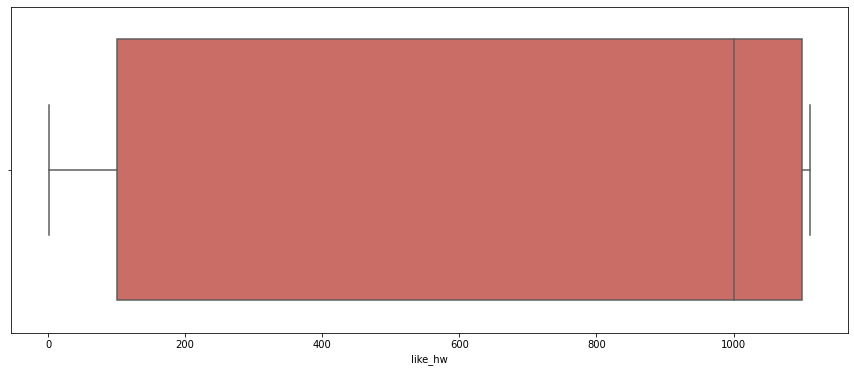

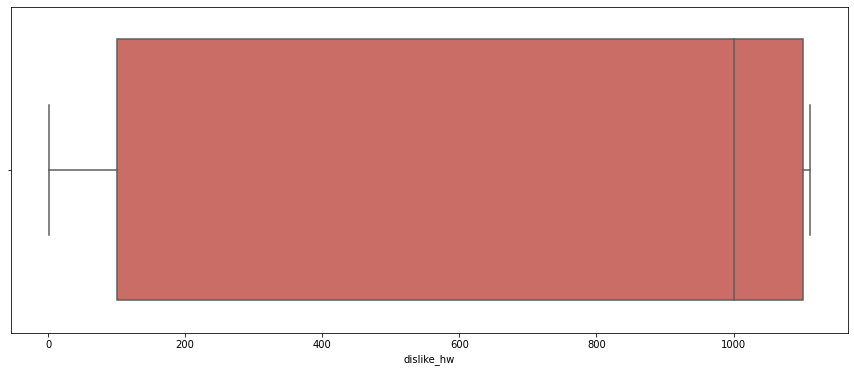

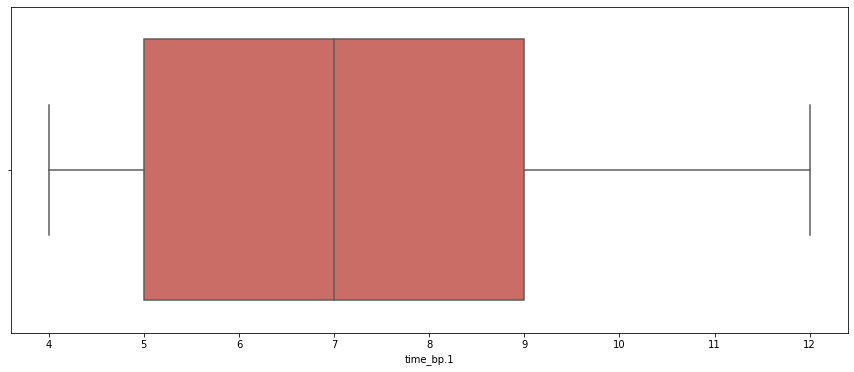

In [29]:
for i in numerical_columns:
    plt.figure(figsize=(15,6))
    sns.boxplot(df[i], data=df, palette='hls')
    plt.xticks(rotation = 0)
    plt.show()

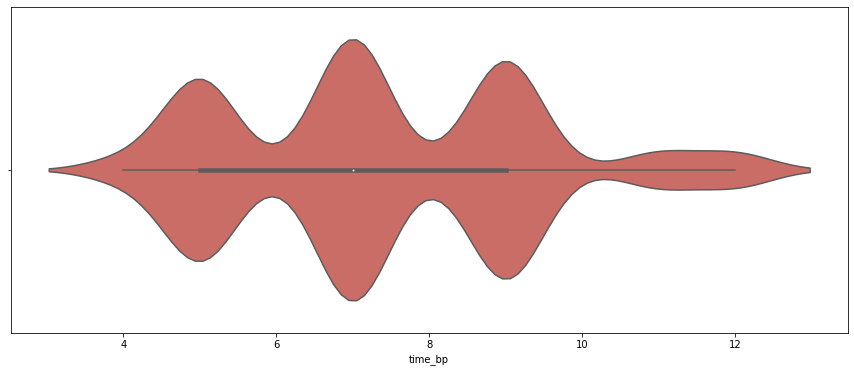

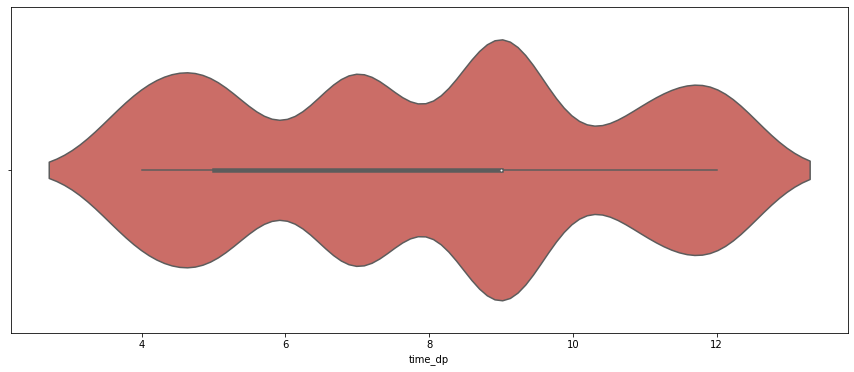

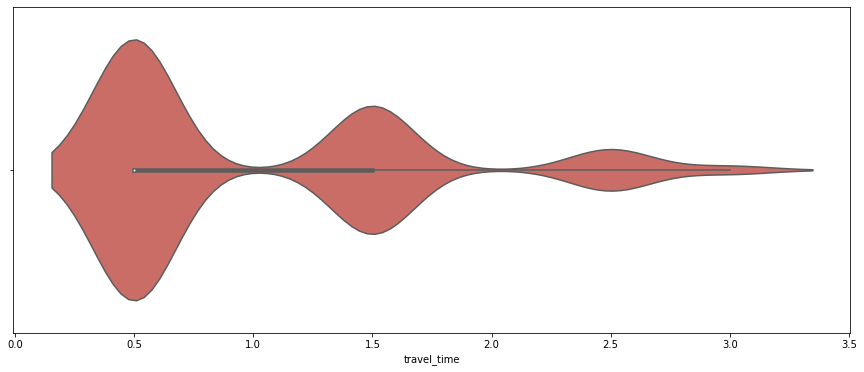

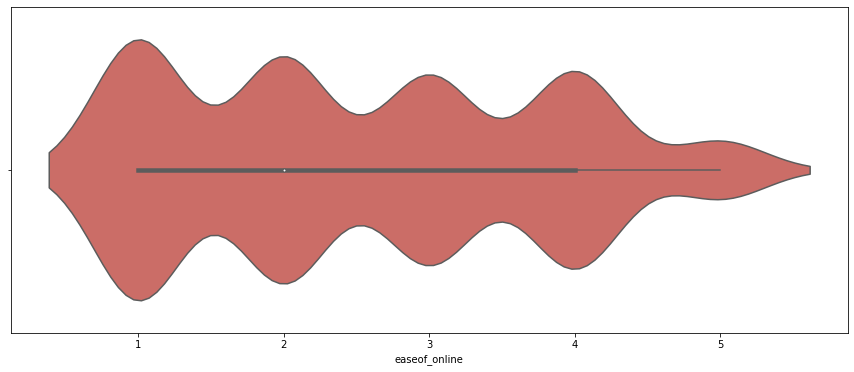

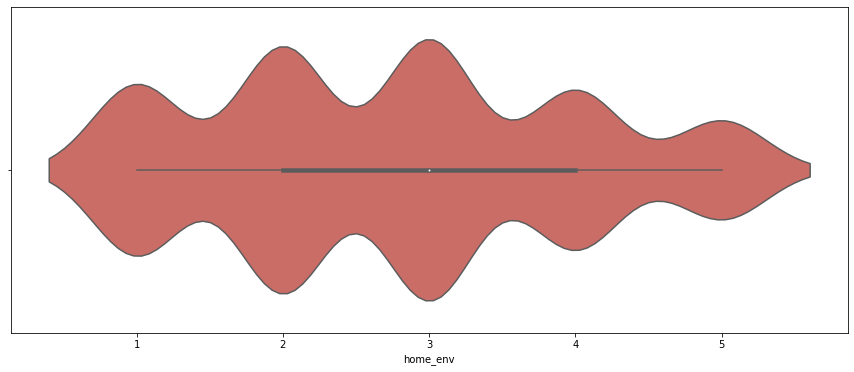

...

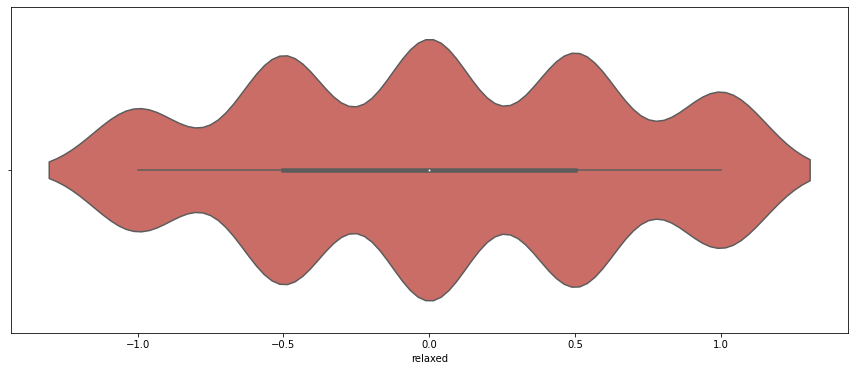

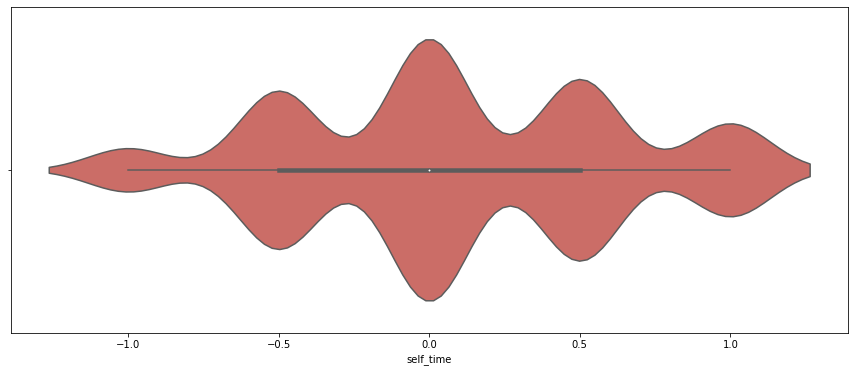

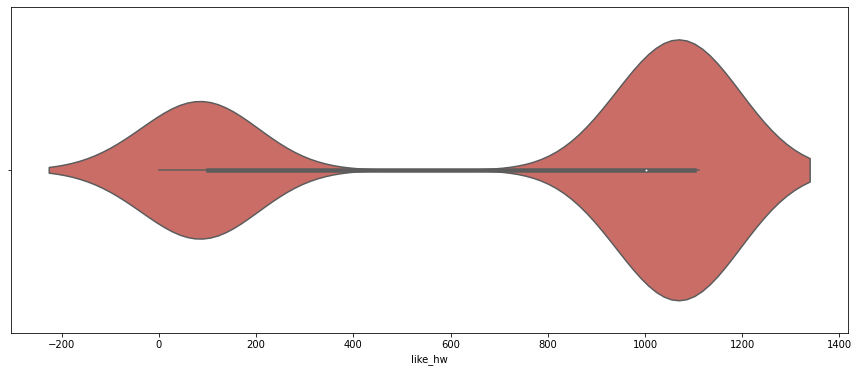

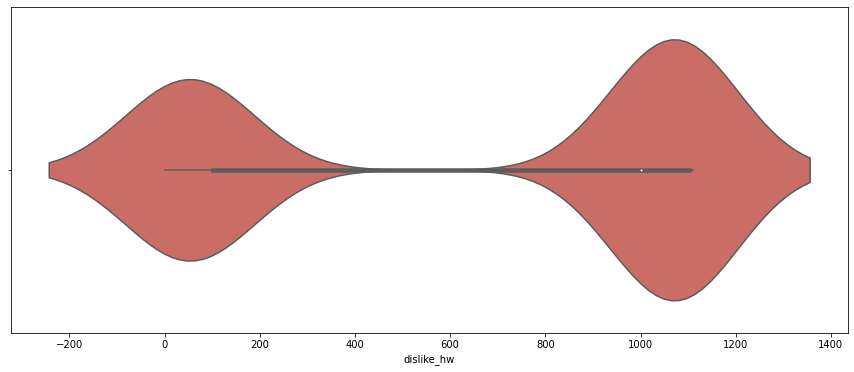

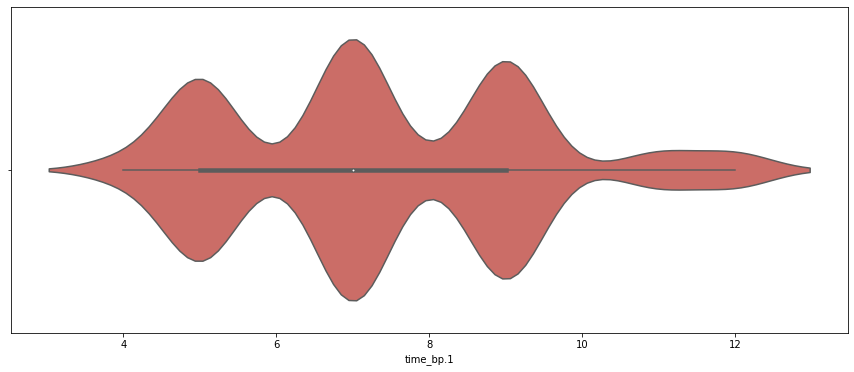

In [30]:
for i in numerical_columns:
    plt.figure(figsize=(15,6))
    sns.violinplot(df[i], data=df, palette='hls')
    plt.xticks(rotation = 0)
    plt.show()

In [31]:
for i in numerical_columns:
    fig = go.Figure(data=[go.Histogram(x=df[i], nbinsx=20)])
    fig.update_layout(
        title=f'Histogram of {i}',
        xaxis_title=i,
        yaxis_title="Count"
    )
    fig.update_traces(marker=dict(line=dict(width=1, color='black')))
    fig.show()

In [32]:
for i in numerical_columns:
    fig = go.Figure(data=[go.Box(x=df[i])])
    fig.update_layout(
        title=i,
        xaxis_title=i,
        yaxis_title="Value")
    fig.show()

In [33]:
for i in numerical_columns:
    fig = go.Figure(data=[go.Violin(x=df[i])])
    fig.update_layout(
        title=i,
        xaxis_title=i,
        yaxis_title="Value")
    fig.show()

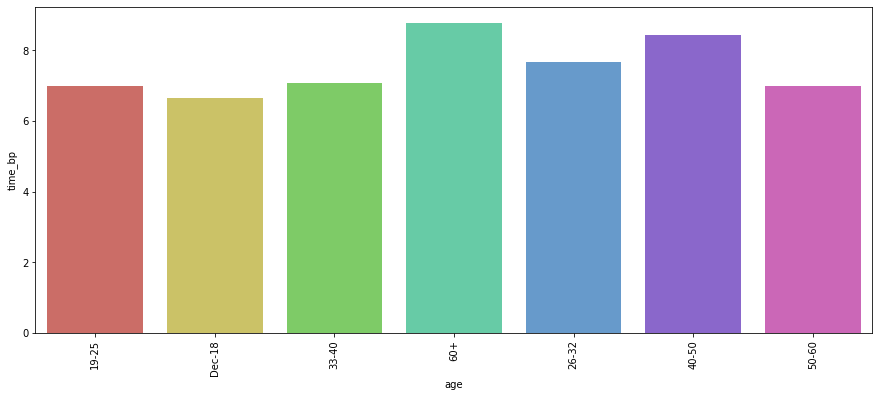

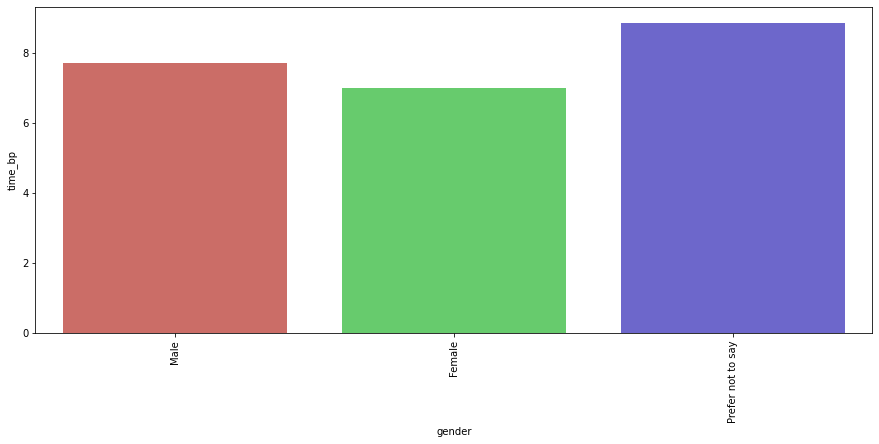

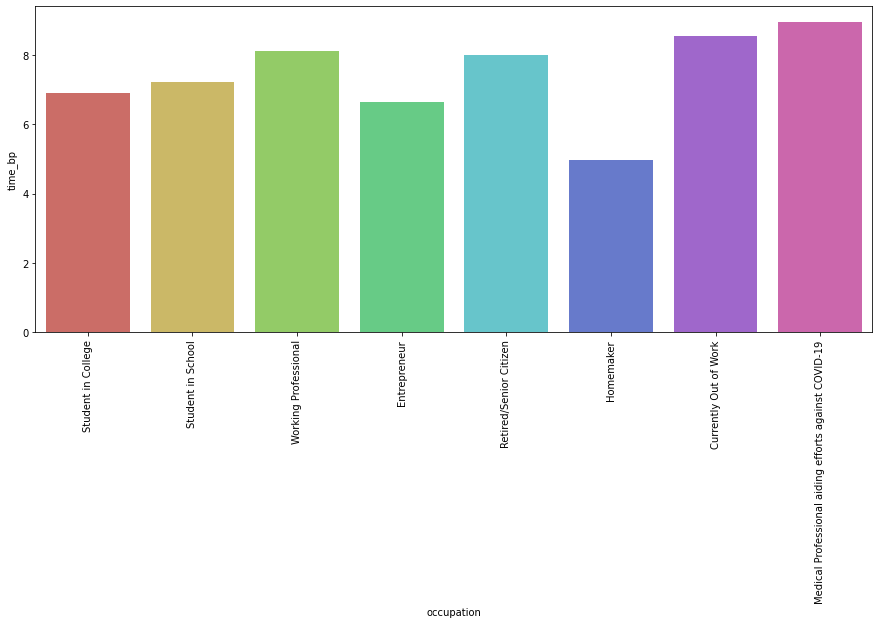

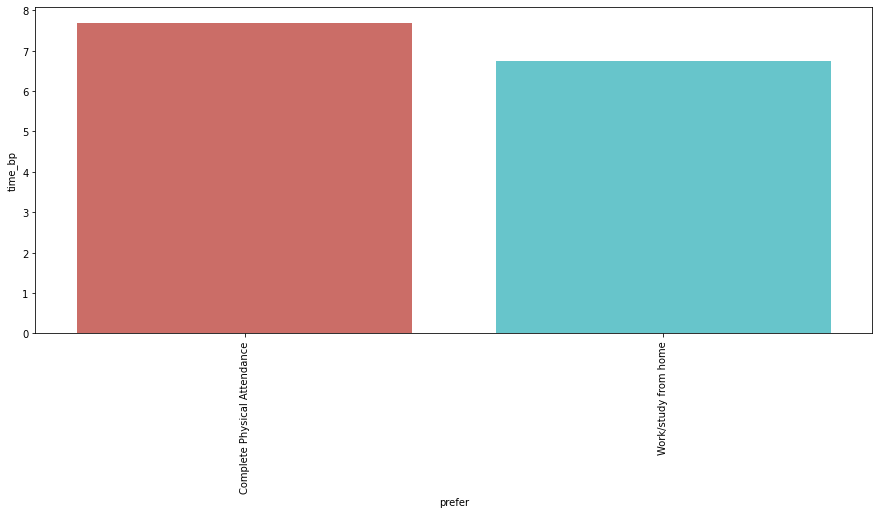

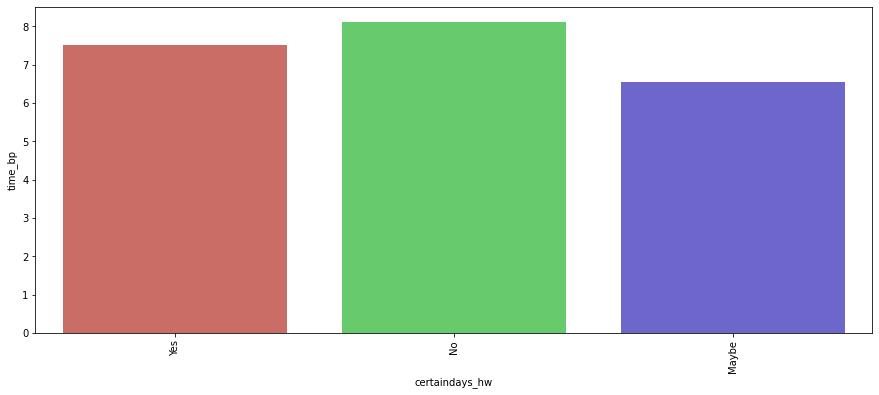

...

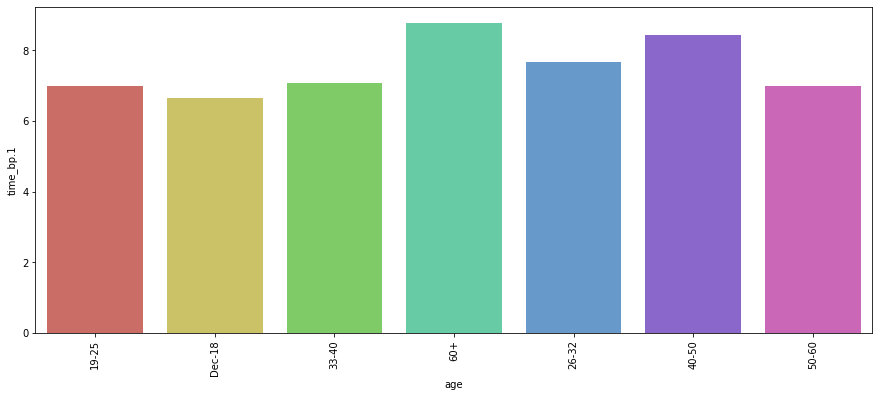

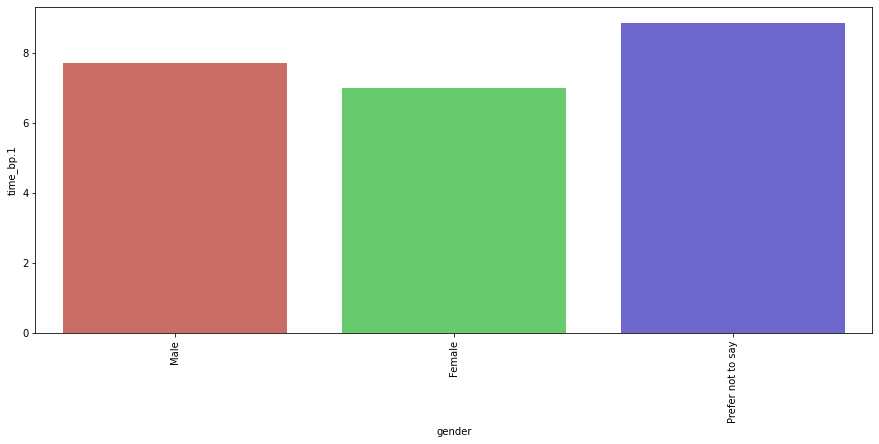

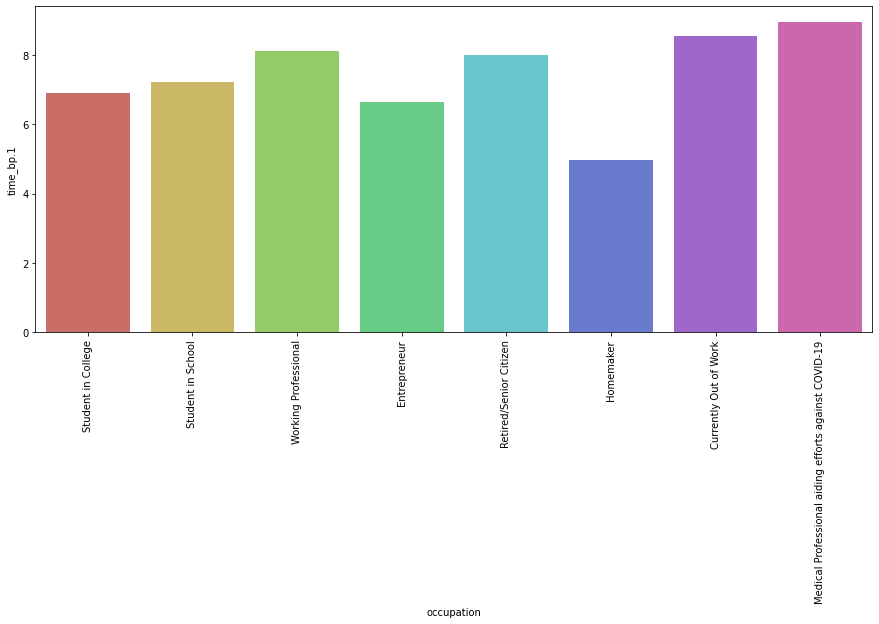

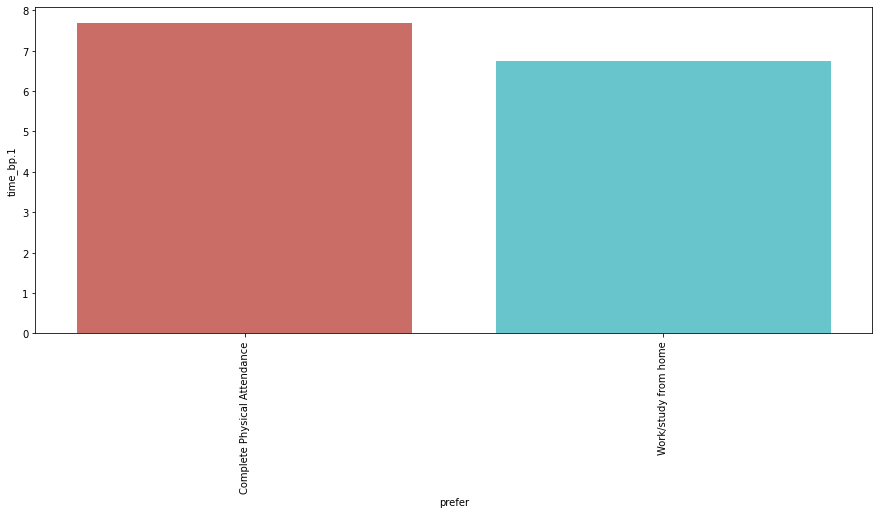

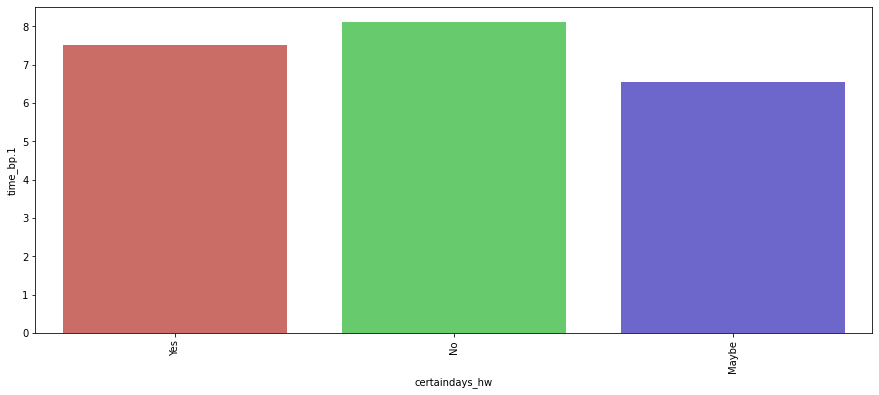

In [34]:
for i in numerical_columns:
    for j in object_columns:
        plt.figure(figsize=(15,6))
        sns.barplot(x = df[j], y = df[i], data = df, ci = None, palette = 'hls')
        plt.xticks(rotation = 90)
        plt.show()

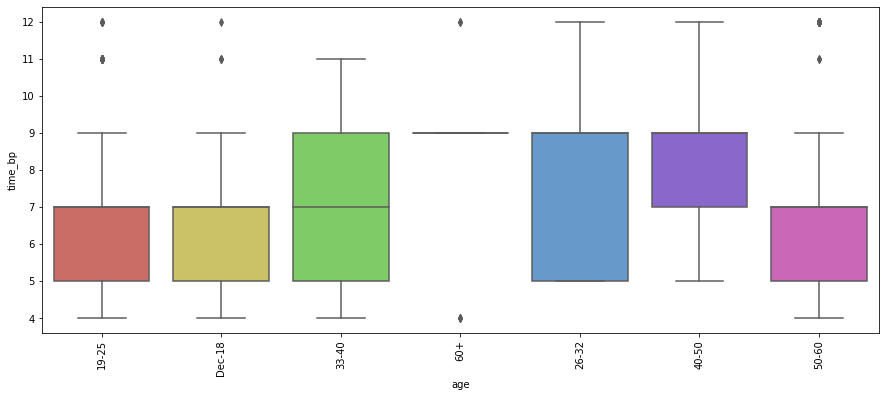

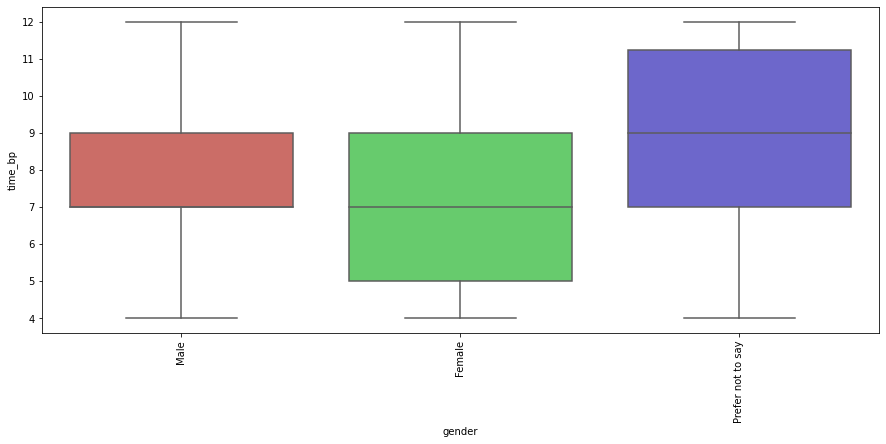

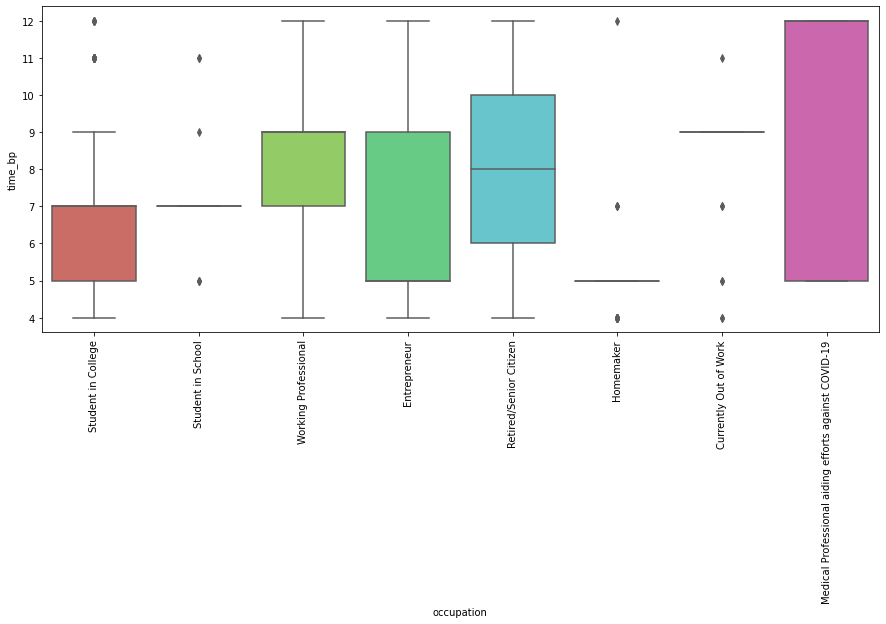

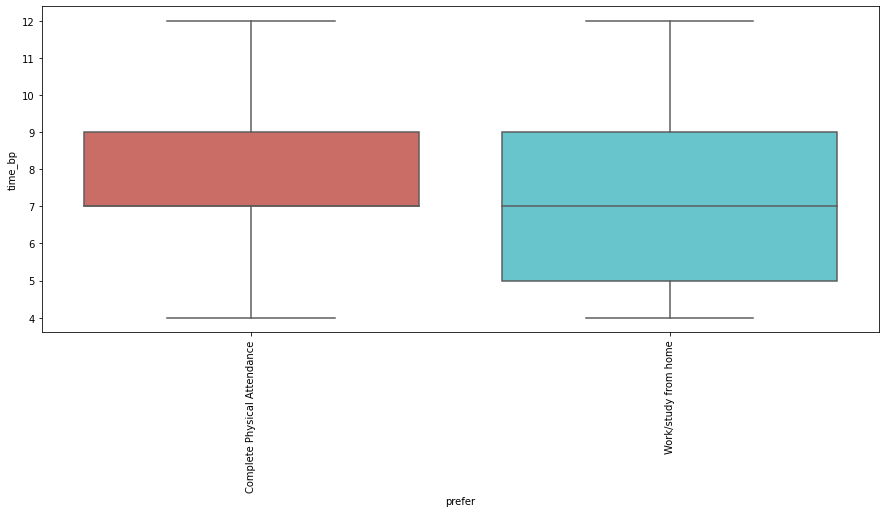

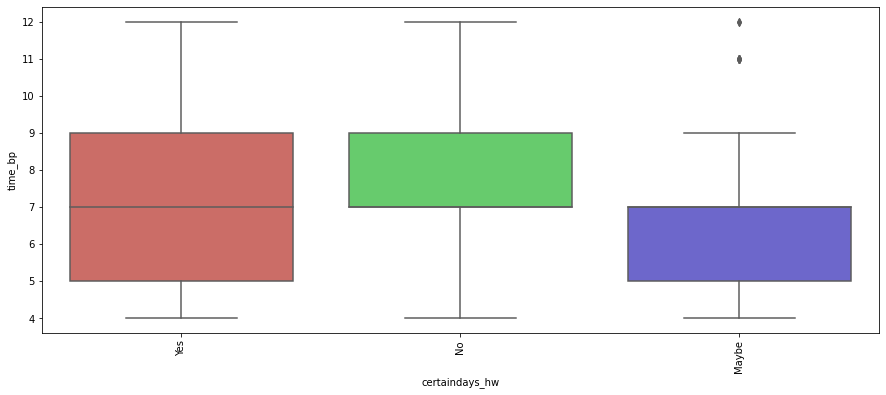

...

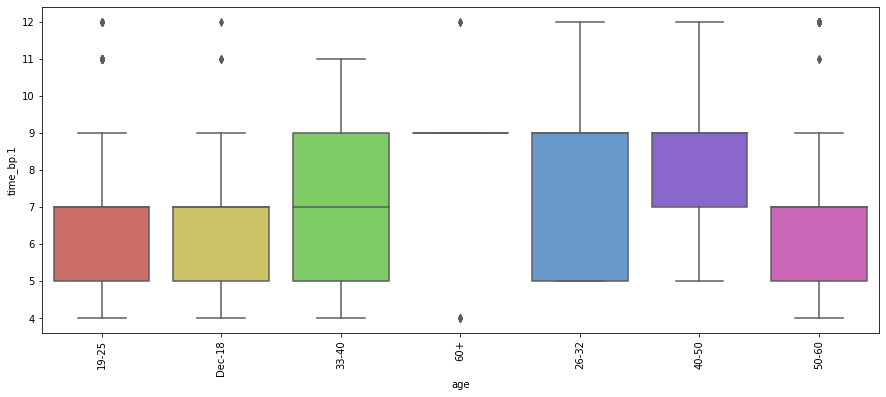

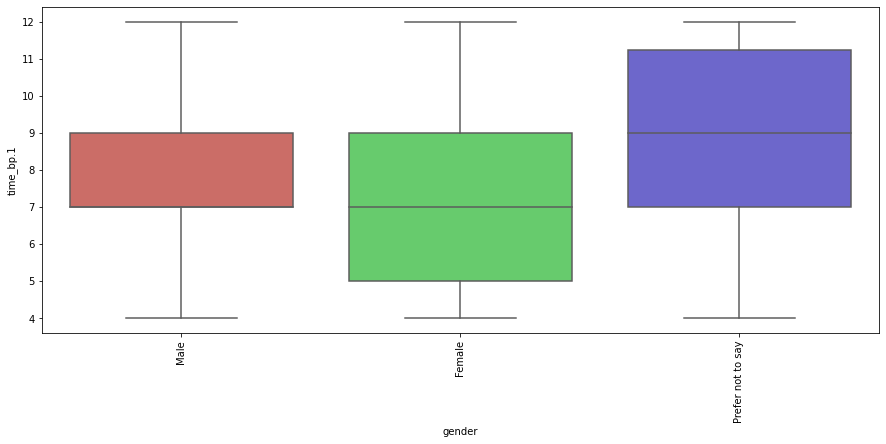

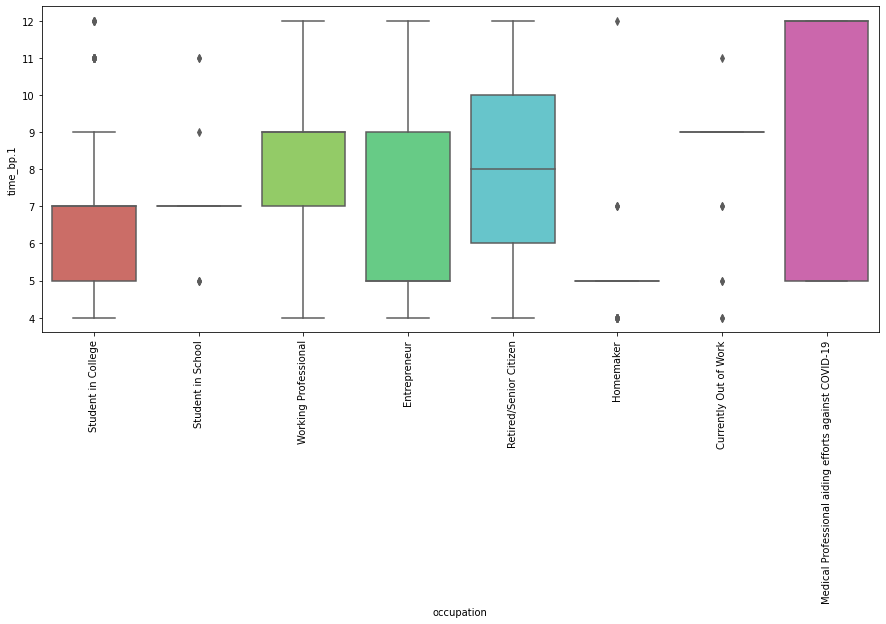

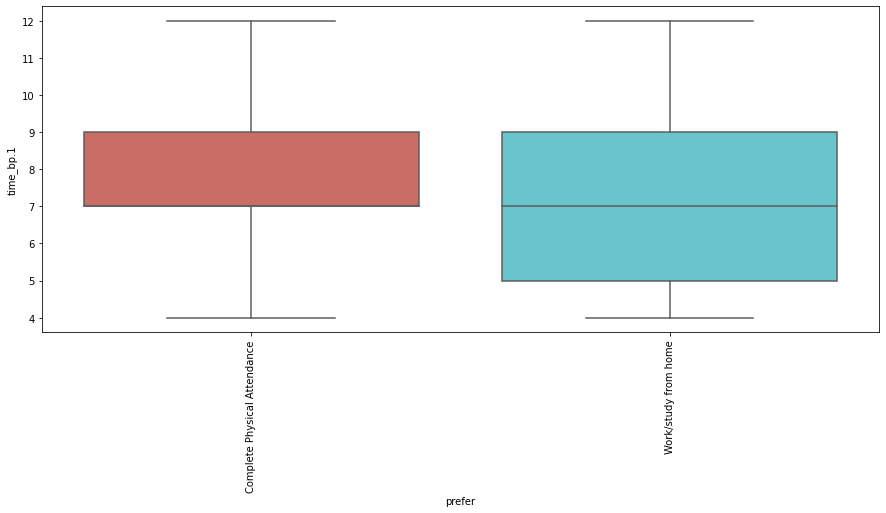

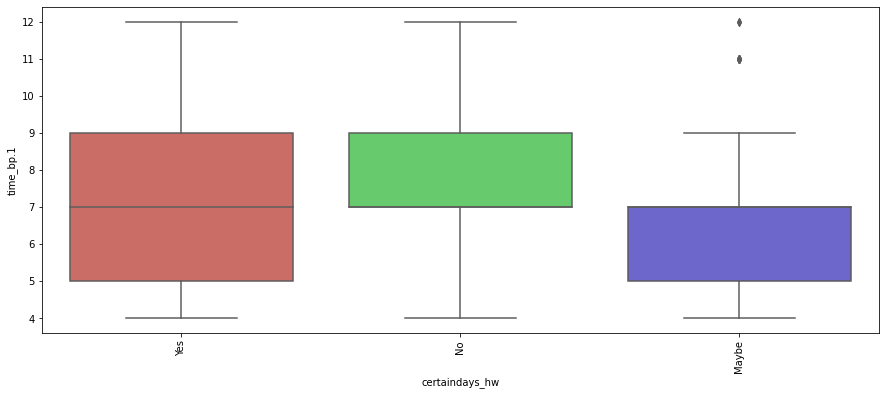

In [35]:
for i in numerical_columns:
    for j in object_columns:
        plt.figure(figsize=(15,6))
        sns.boxplot(x = df[j], y = df[i], data = df, palette = 'hls')
        plt.xticks(rotation = 90)
        plt.show()

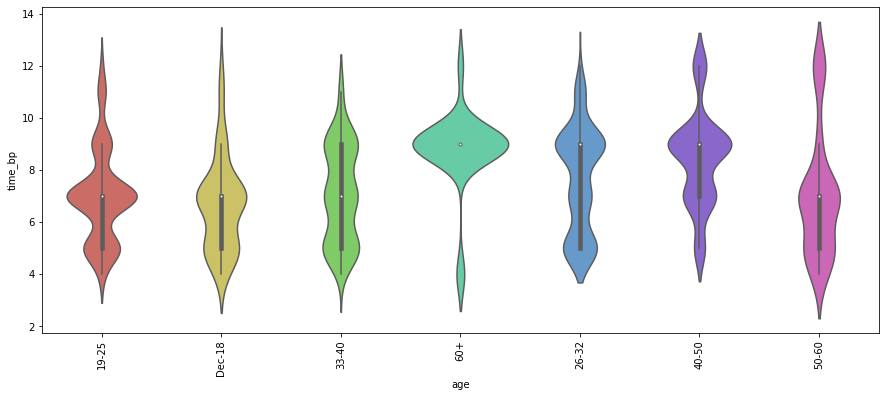

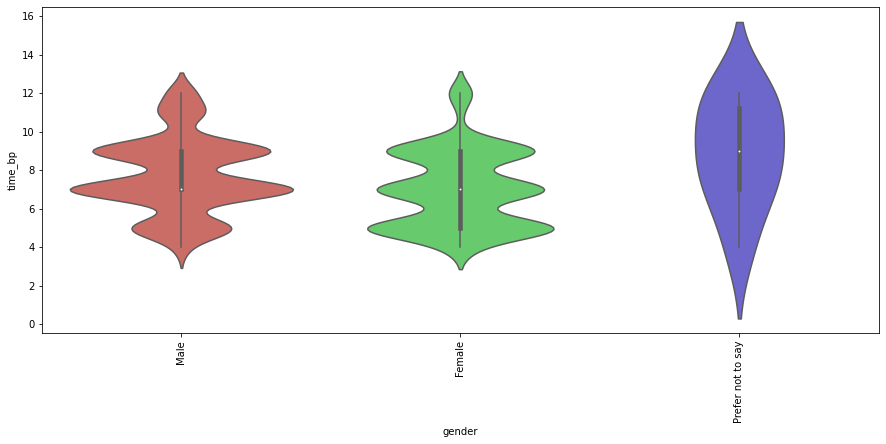

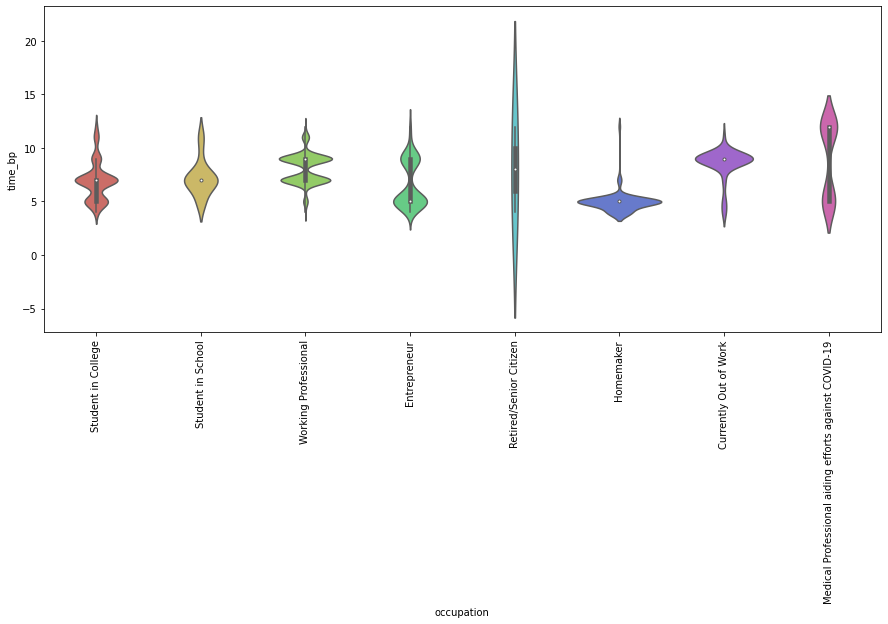

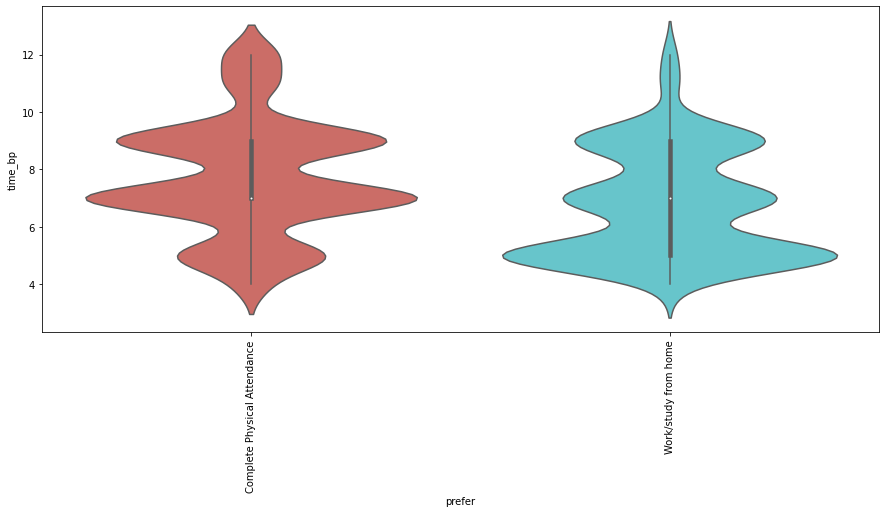

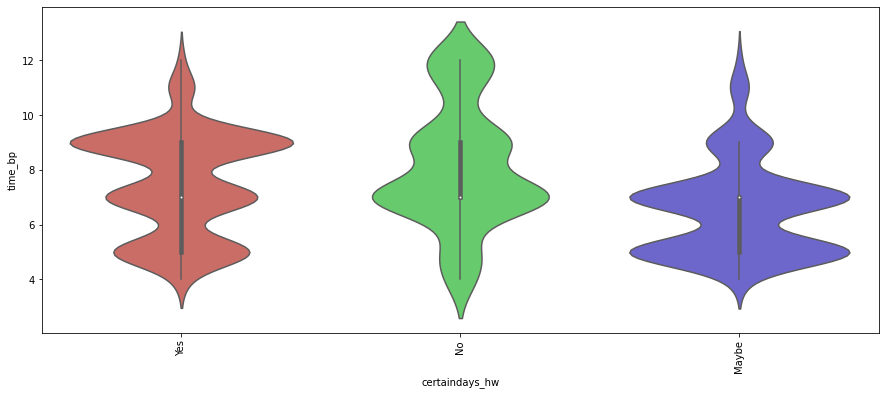

...

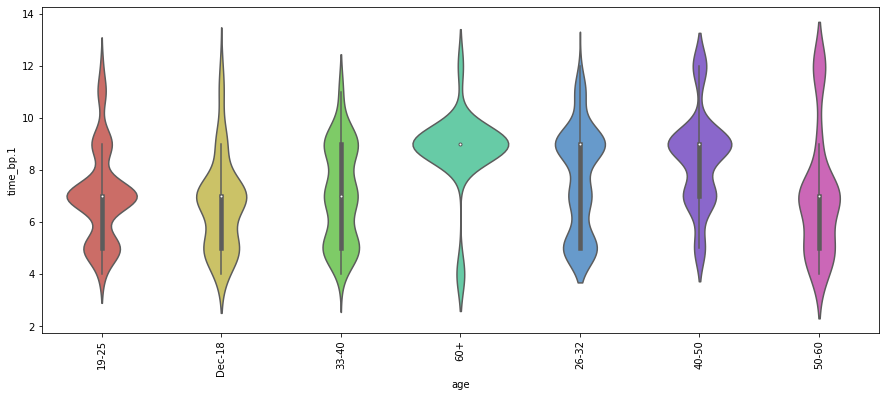

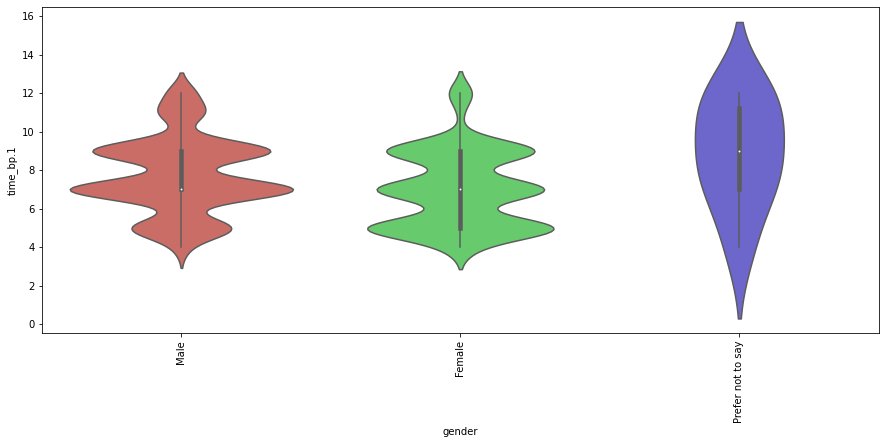

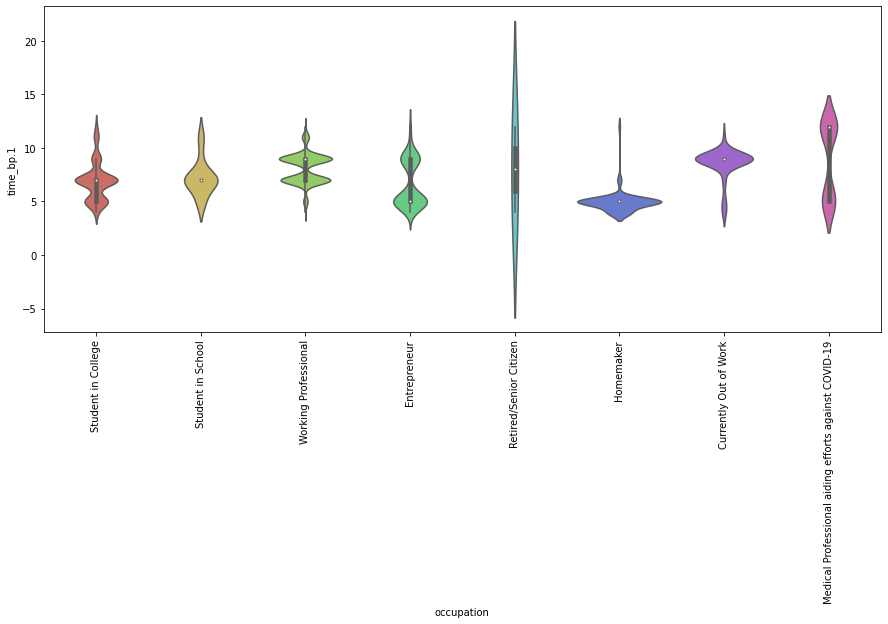

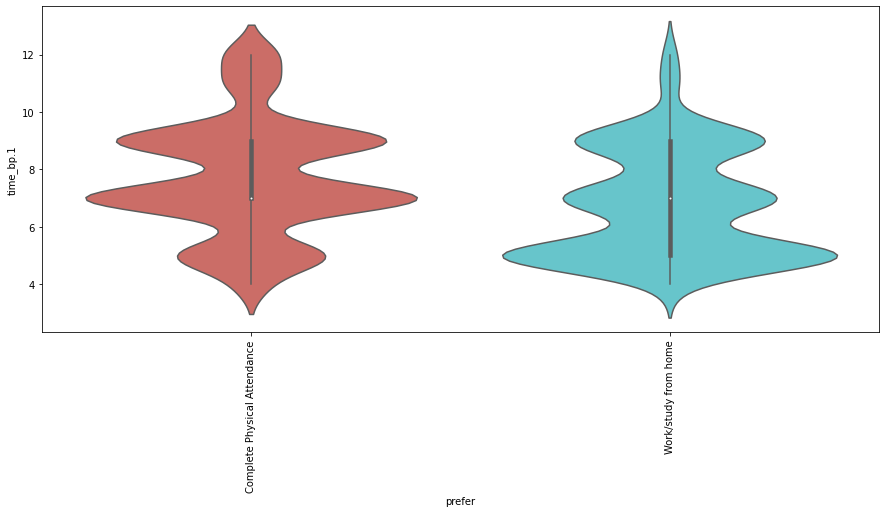

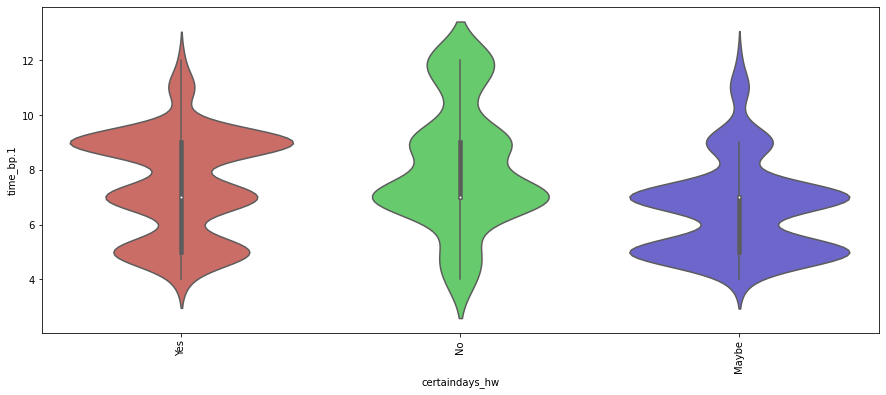

In [36]:
for i in numerical_columns:
    for j in object_columns:
        plt.figure(figsize=(15,6))
        sns.violinplot(x = df[j], y = df[i], data = df, palette = 'hls')
        plt.xticks(rotation = 90)
        plt.show()

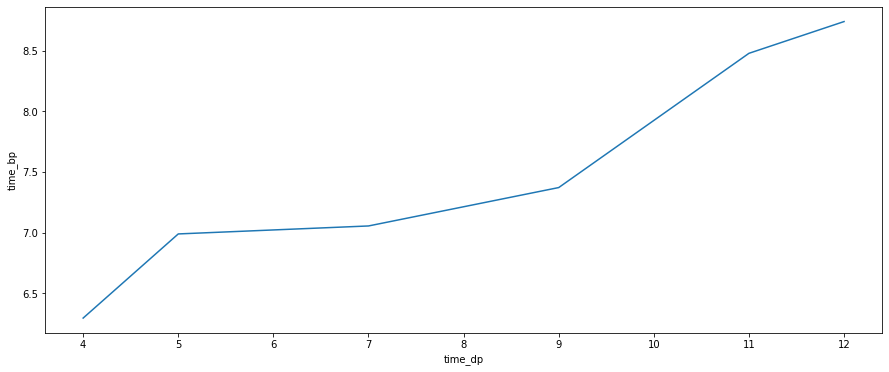

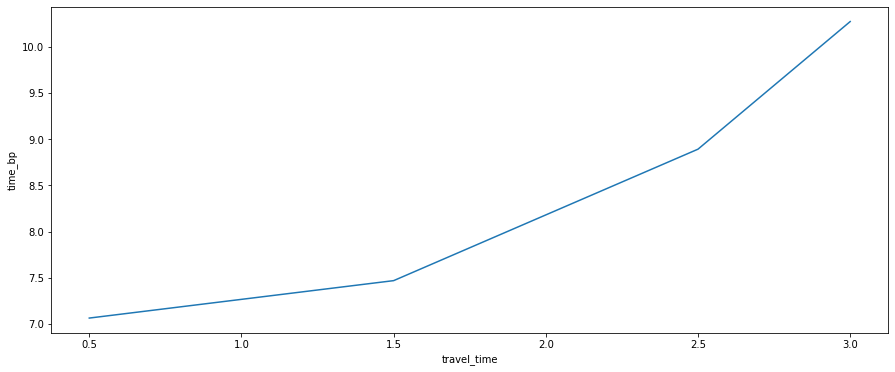

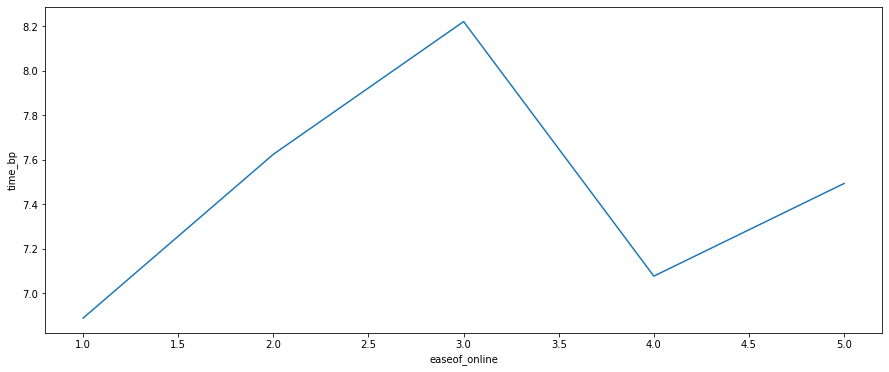

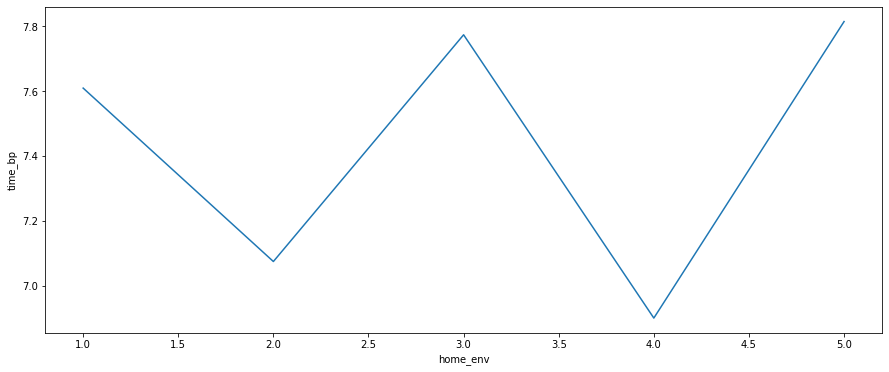

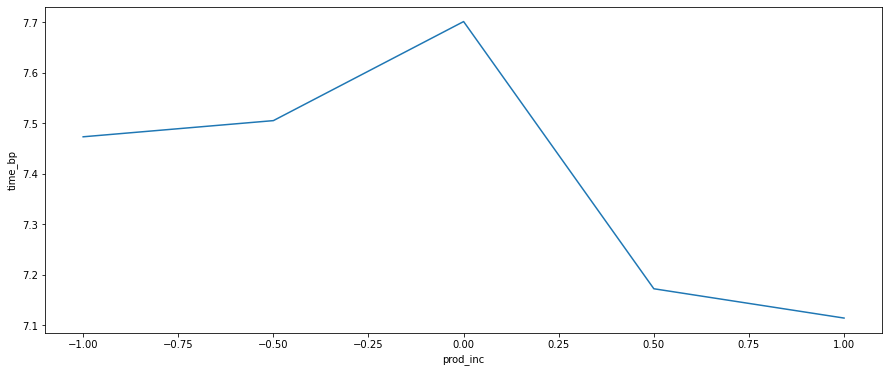

...

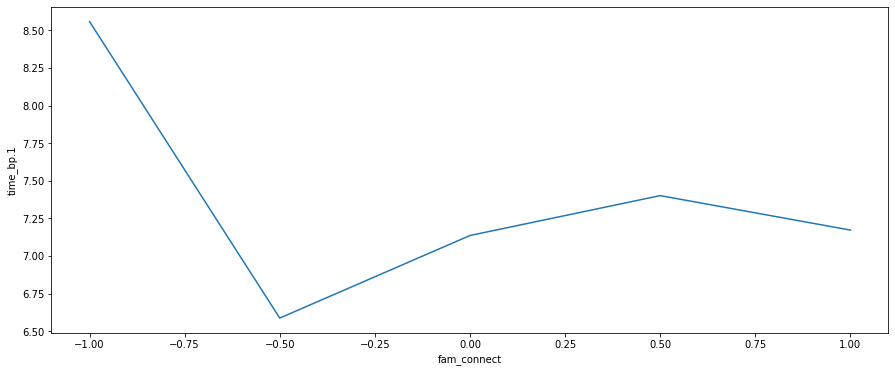

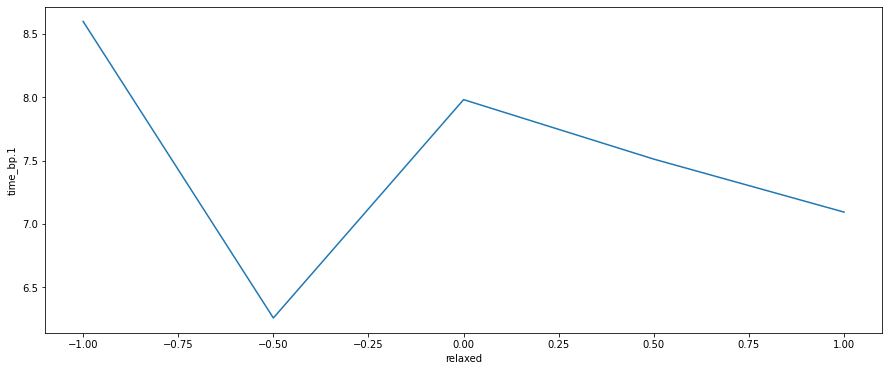

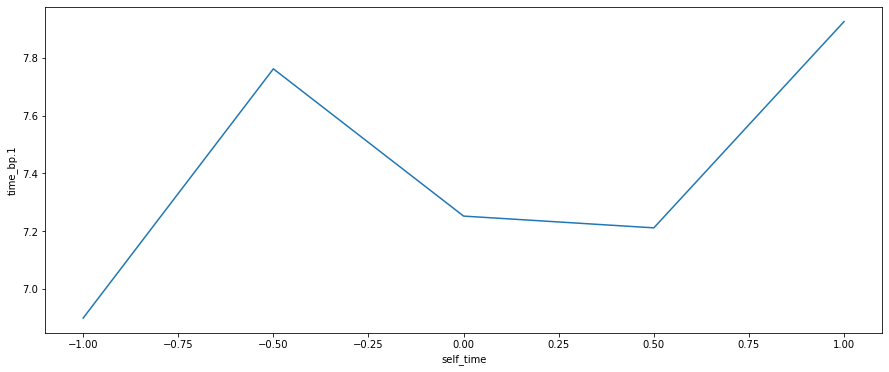

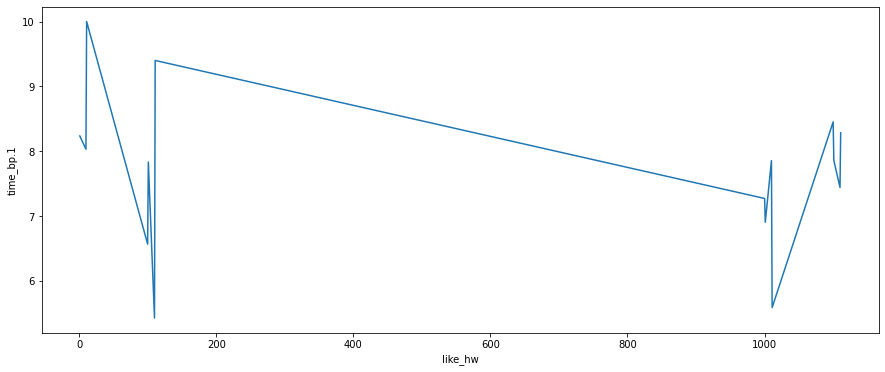

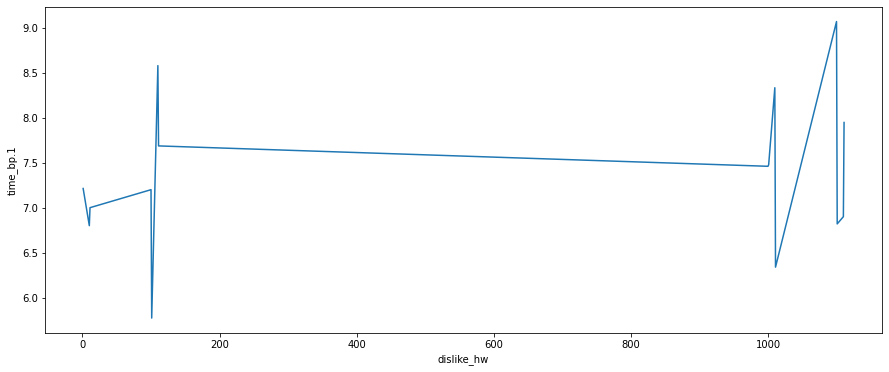

In [37]:
for i in numerical_columns:
    for j in numerical_columns:
        if i != j:
            plt.figure(figsize=(15,6))
            sns.lineplot(x = df[j], y = df[i], data = df, ci = None, palette = 'hls')
            plt.show()

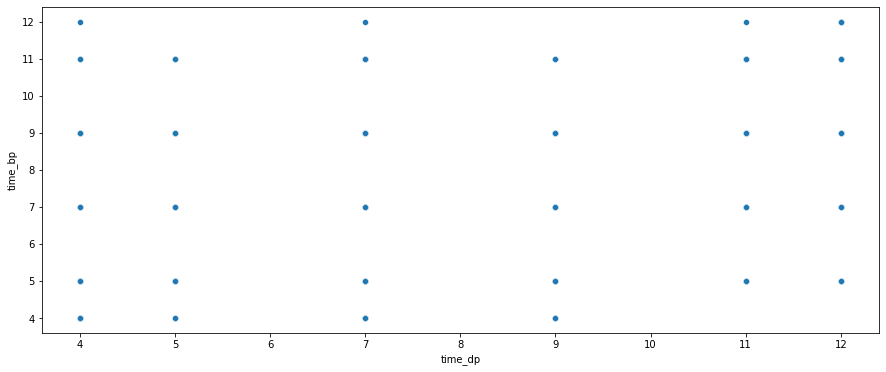

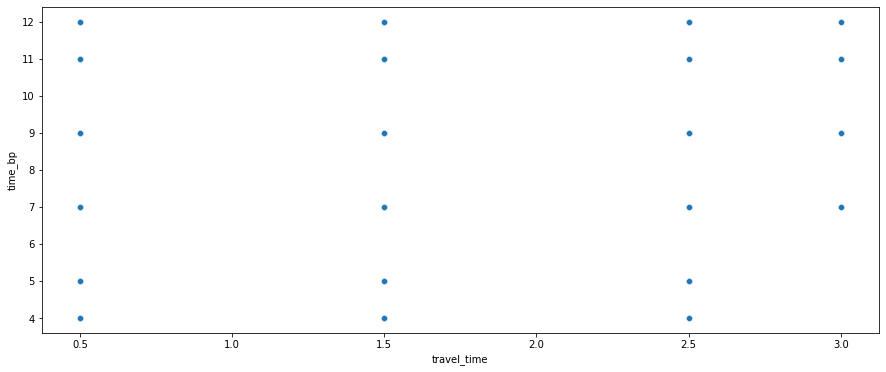

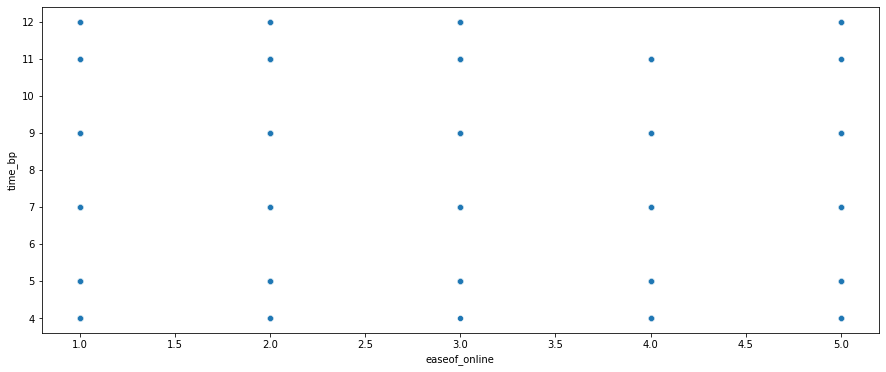

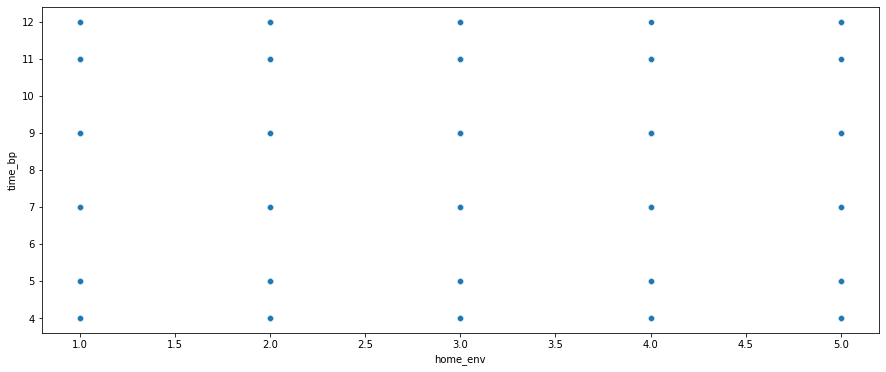

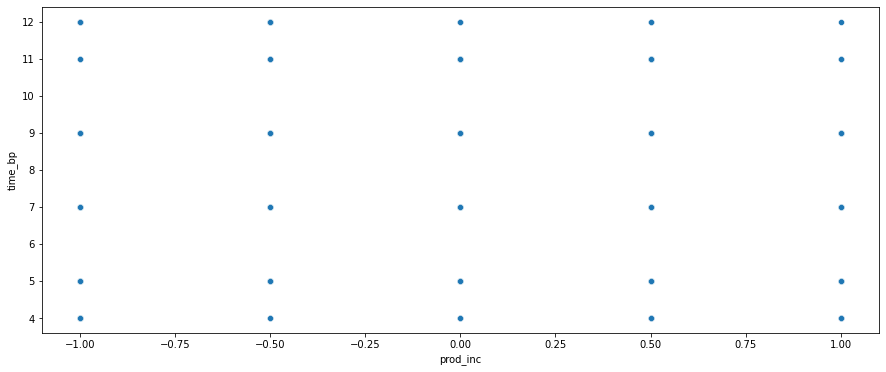

...

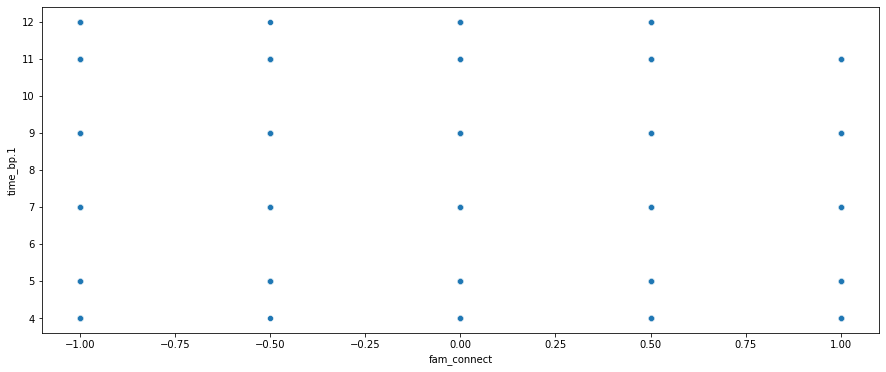

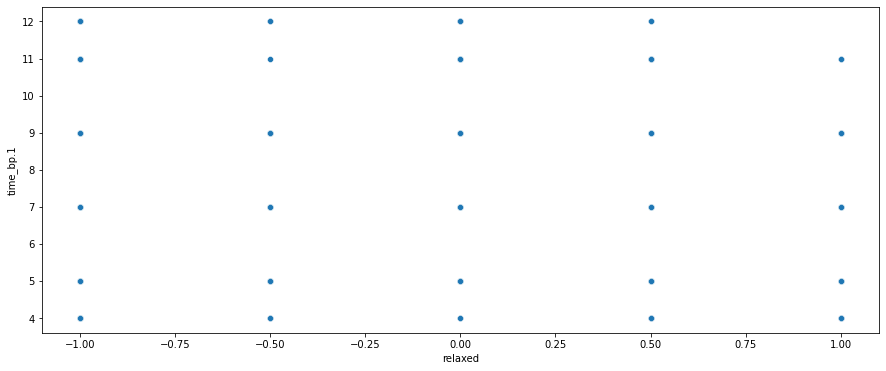

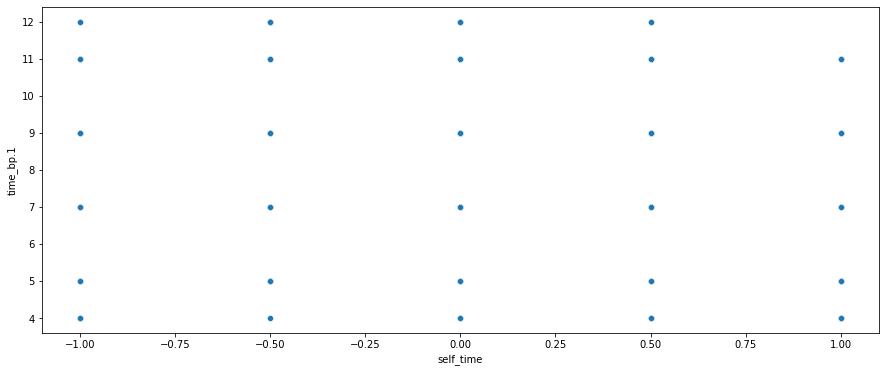

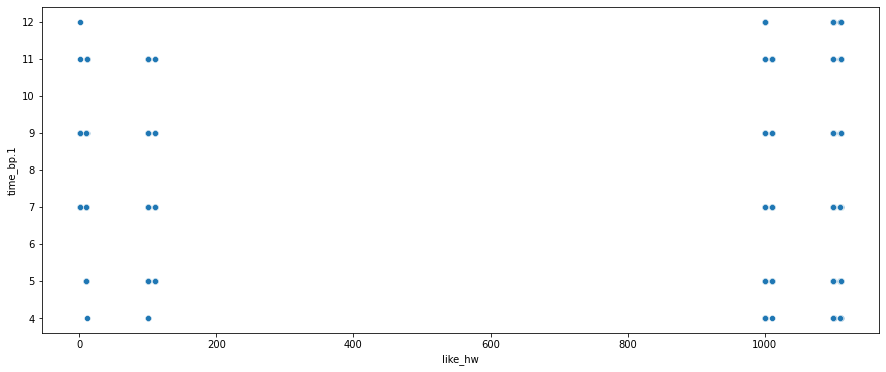

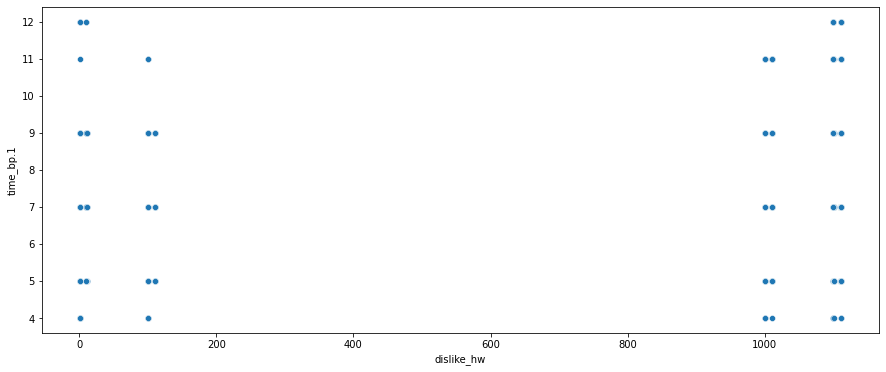

In [38]:
for i in numerical_columns:
    for j in numerical_columns:
        if i != j:
            plt.figure(figsize=(15,6))
            sns.scatterplot(x = df[j], y = df[i], data = df, palette = 'hls')
            plt.show()

In [39]:
df.columns

Index(['age', 'gender', 'occupation', 'time_bp', 'time_dp', 'travel_time',
       'easeof_online', 'home_env', 'prod_inc', 'sleep_bal', 'new_skill',
       'fam_connect', 'relaxed', 'self_time', 'like_hw', 'dislike_hw',
       'prefer', 'certaindays_hw', 'time_bp.1'],
      dtype='object')

In [40]:
df['age'].unique()

array(['19-25', 'Dec-18', '33-40', '60+', '26-32', '40-50', '50-60'],
      dtype=object)

In [41]:
age_mapping = {
    '19-25': 22,
    'Dec-18': 18,  
    '33-40': 36.5,
    '60+': 65,
    '26-32': 29,
    '40-50': 45,
    '50-60': 55
}

In [42]:
df['age'] = df['age'].map(age_mapping)

In [43]:
fig = px.bar(
    df,
    x='occupation',
    y='age',
    title='Average Age by Occupation',
    color='time_bp',  
    barmode='group'
)
fig.show()

In [44]:
fig = px.box(
    df,
    x='gender',
    y='prod_inc',
    title='Productivity Income by Gender',
    color='time_dp',  
    points='all'
)
fig.show()

In [45]:
fig = px.scatter(
    df,
    x='sleep_bal',
    y='relaxed',
    title='Sleep Balance vs. Relaxation',
    color='time_bp',  
    hover_name='occupation'
)
fig.show()

<Figure size 864x576 with 0 Axes>

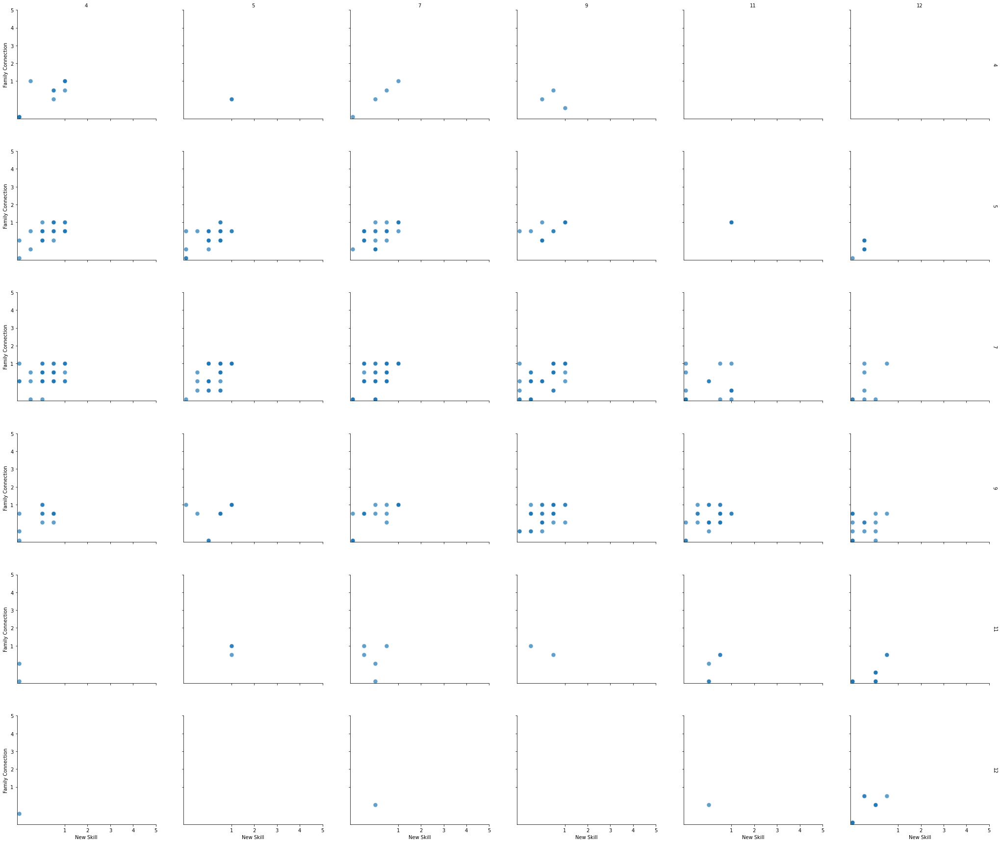

In [46]:
plt.figure(figsize=(12, 8))
g = sns.FacetGrid(df, col='time_dp', row='time_bp',
                  margin_titles=True, height=4, aspect=1.2)
g.map(sns.scatterplot, 'new_skill', 'fam_connect', alpha=0.7, s=80)
g.set_titles(col_template="{col_name}", row_template="{row_name}")
g.set(xticks=[1, 2, 3, 4, 5], yticks=[1, 2, 3, 4, 5])
g.set_axis_labels('New Skill', 'Family Connection')
plt.subplots_adjust(wspace=0.2, hspace=0.3)
plt.show()

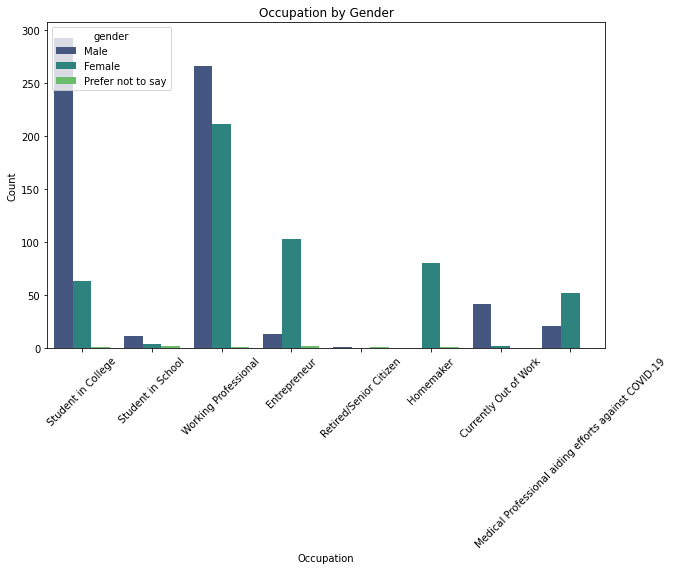

In [47]:
plt.figure(figsize=(10, 6))
sns.countplot(x='occupation', hue='gender', data=df, palette='viridis')
plt.title('Occupation by Gender')
plt.xlabel('Occupation')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.show()

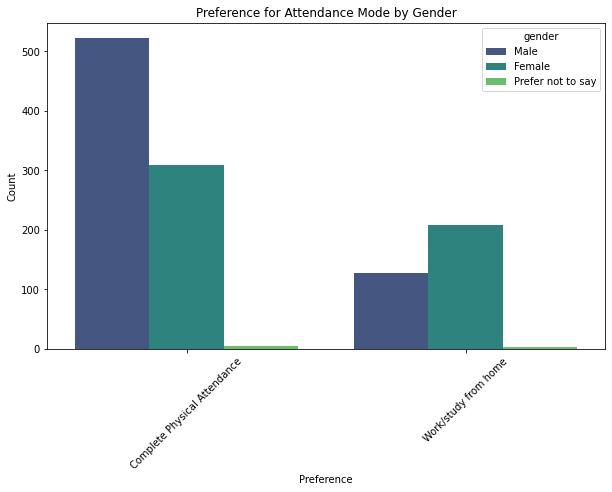

In [48]:
plt.figure(figsize=(10, 6))
sns.countplot(x='prefer', hue='gender', data=df, palette='viridis')
plt.title('Preference for Attendance Mode by Gender')
plt.xlabel('Preference')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.show()

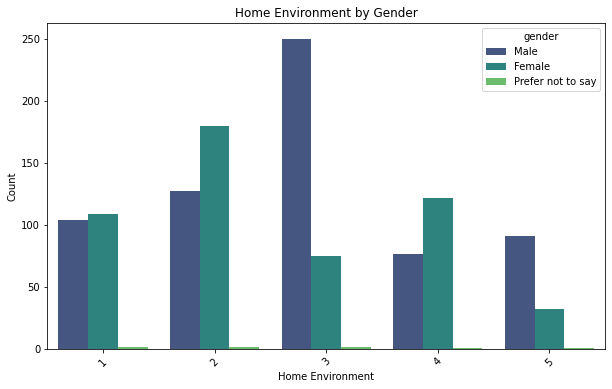

In [49]:
plt.figure(figsize=(10, 6))
sns.countplot(x='home_env', hue='gender', data=df, palette='viridis')
plt.title('Home Environment by Gender')
plt.xlabel('Home Environment')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.show()

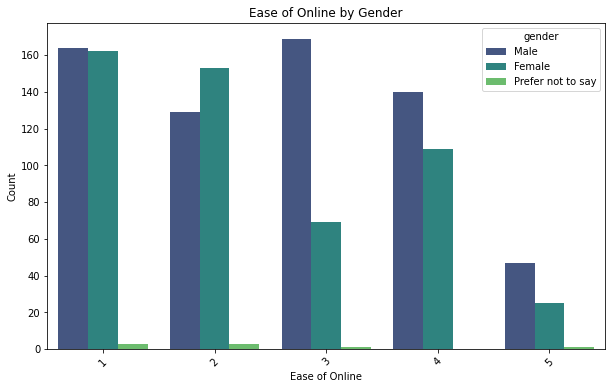

In [50]:
plt.figure(figsize=(10, 6))
sns.countplot(x='easeof_online', hue='gender', data=df, palette='viridis')
plt.title('Ease of Online by Gender')
plt.xlabel('Ease of Online')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.show()

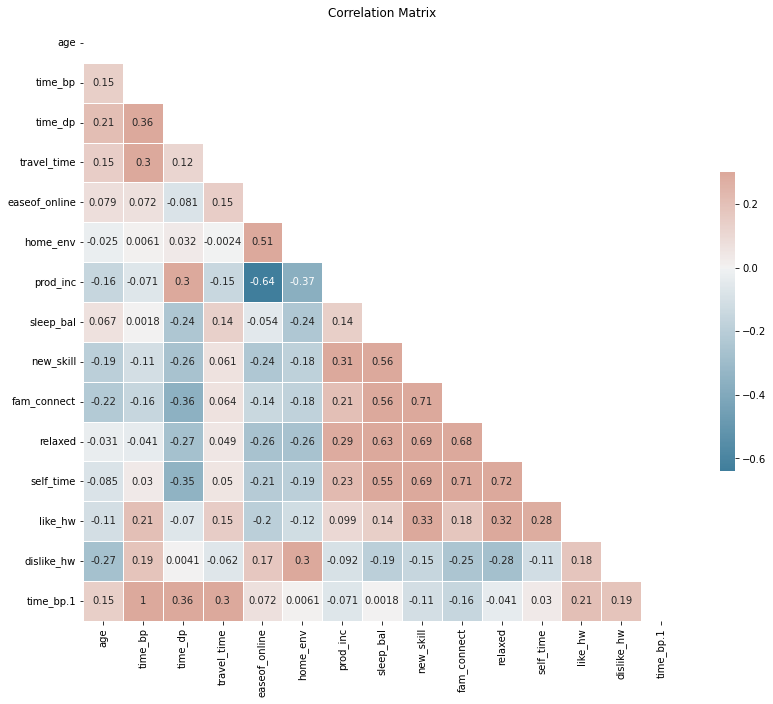

In [51]:
corr = df.corr()
mask = np.triu(np.ones_like(corr, dtype=bool))
fig, ax = plt.subplots(figsize=(14, 11))
cmap = sns.diverging_palette(230, 20, as_cmap=True)
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True)
plt.title('Correlation Matrix')
plt.show()

In [52]:
df.columns

Index(['age', 'gender', 'occupation', 'time_bp', 'time_dp', 'travel_time',
       'easeof_online', 'home_env', 'prod_inc', 'sleep_bal', 'new_skill',
       'fam_connect', 'relaxed', 'self_time', 'like_hw', 'dislike_hw',
       'prefer', 'certaindays_hw', 'time_bp.1'],
      dtype='object')

In [53]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1175 entries, 0 to 1174
Data columns (total 19 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   age             1175 non-null   float64
 1   gender          1175 non-null   object 
 2   occupation      1175 non-null   object 
 3   time_bp         1175 non-null   int64  
 4   time_dp         1175 non-null   int64  
 5   travel_time     1175 non-null   float64
 6   easeof_online   1175 non-null   int64  
 7   home_env        1175 non-null   int64  
 8   prod_inc        1175 non-null   float64
 9   sleep_bal       1175 non-null   float64
 10  new_skill       1175 non-null   float64
 11  fam_connect     1175 non-null   float64
 12  relaxed         1175 non-null   float64
 13  self_time       1175 non-null   float64
 14  like_hw         1175 non-null   int64  
 15  dislike_hw      1175 non-null   int64  
 16  prefer          1175 non-null   object 
 17  certaindays_hw  1175 non-null   o

In [54]:
change_columns = ['prod_inc', 'sleep_bal', 'new_skill', 'fam_connect', 'relaxed', 'self_time']
df['lifestyle_change'] = df[change_columns].apply(lambda row: np.any(np.abs(row) > 0.5), axis=1).astype(int)

In [55]:
df['lifestyle_change'].unique()

array([1, 0])

In [56]:
df['lifestyle_change'].value_counts()

1    761
0    414
Name: lifestyle_change, dtype: int64

In [57]:
fig = go.Figure(data=[go.Bar(x=df['lifestyle_change'].value_counts().index, y=df['lifestyle_change'].value_counts())])
fig.update_layout(title= 'lifestyle_change', xaxis_title= 'lifestyle_change', yaxis_title="Count")
fig.show()

In [58]:
counts = df['lifestyle_change'].value_counts()
fig = go.Figure(data=[go.Pie(labels=counts.index, values=counts)])
fig.update_layout(title= 'lifestyle_change')
fig.show()

In [59]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline

In [60]:
numerical_transformer = StandardScaler()

In [61]:
categorical_transformer = OneHotEncoder(handle_unknown='ignore')

In [62]:
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numerical_transformer, numerical_columns),
        ('cat', categorical_transformer, object_columns)
    ])

In [63]:
X = df.drop(columns='lifestyle_change')
y = df['lifestyle_change']

In [64]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify = y, random_state=0)

In [65]:
preprocessor.fit(X_train)
X_train = preprocessor.transform(X_train)
X_test = preprocessor.transform(X_test)

In [66]:
X_train.shape, X_test.shape

((940, 37), (235, 37))

In [67]:
y_train.shape, y_test.shape

((940,), (235,))

In [68]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report

In [69]:
model_lr = LogisticRegression()
model_lr.fit(X_train, y_train)

LogisticRegression()

In [70]:
y_pred = model_lr.predict(X_test)

In [71]:
accuracy_lr = accuracy_score(y_test, y_pred)

In [72]:
print("Accuracy: ", accuracy_lr * 100)
print("\nClassification Report: \n", classification_report(y_test, y_pred))

Accuracy:  82.12765957446808

Classification Report: 
               precision    recall  f1-score   support

           0       0.74      0.76      0.75        83
           1       0.87      0.86      0.86       152

    accuracy                           0.82       235
   macro avg       0.80      0.81      0.81       235
weighted avg       0.82      0.82      0.82       235



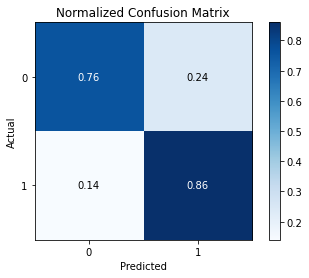

In [73]:
import scikitplot as skplt
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_test, y_pred)
skplt.metrics.plot_confusion_matrix(y_test, y_pred, normalize=True)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Normalized Confusion Matrix')
plt.show()

In [74]:
from sklearn.ensemble import RandomForestClassifier

In [75]:
model_rf = RandomForestClassifier()
model_rf.fit(X_train, y_train)

RandomForestClassifier()

In [76]:
y_pred = model_rf.predict(X_test)

In [77]:
accuracy_rf = accuracy_score(y_test, y_pred)

In [78]:
print("Accuracy: ", accuracy_rf * 100)
print("\nClassification Report: \n", classification_report(y_test, y_pred))

Accuracy:  98.72340425531915

Classification Report: 
               precision    recall  f1-score   support

           0       0.98      0.99      0.98        83
           1       0.99      0.99      0.99       152

    accuracy                           0.99       235
   macro avg       0.98      0.99      0.99       235
weighted avg       0.99      0.99      0.99       235



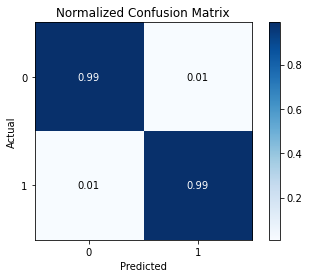

In [79]:
cm = confusion_matrix(y_test, y_pred)
skplt.metrics.plot_confusion_matrix(y_test, y_pred, normalize=True)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Normalized Confusion Matrix')
plt.show()

In [80]:
from sklearn.tree import DecisionTreeClassifier

In [81]:
model_dt = DecisionTreeClassifier()

In [82]:
model_dt.fit(X_train, y_train)

DecisionTreeClassifier()

In [83]:
y_pred = model_dt.predict(X_test)

In [84]:
accuracy_dt = accuracy_score(y_test, y_pred)

In [85]:
print("Accuracy: ", accuracy_dt * 100)
print("\nClassification Report: \n", classification_report(y_test, y_pred))

Accuracy:  99.57446808510639

Classification Report: 
               precision    recall  f1-score   support

           0       1.00      0.99      0.99        83
           1       0.99      1.00      1.00       152

    accuracy                           1.00       235
   macro avg       1.00      0.99      1.00       235
weighted avg       1.00      1.00      1.00       235



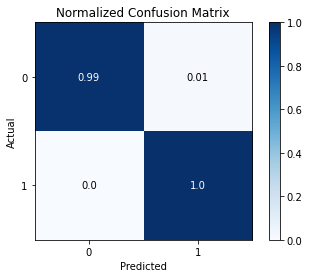

In [86]:
cm = confusion_matrix(y_test, y_pred)
skplt.metrics.plot_confusion_matrix(y_test, y_pred, normalize=True)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Normalized Confusion Matrix')
plt.show()

In [87]:
model_names = ['Logistic Regression', 'Random Forest', 'Decision Tree']
accuracies = [accuracy_lr, accuracy_rf, accuracy_dt]
data = {'Model': model_names, 'Accuracy': accuracies}
df_accuracy = pd.DataFrame(data)
fig = px.bar(df_accuracy, x='Model', y='Accuracy', color='Model', title='Model Accuracy Comparison')
fig.show()

In [111]:
import pickle

In [112]:
filename = 'decision_tree_model_covid1.pkl'
with open(filename, 'wb') as file:
    pickle.dump(model_dt, file)

In [88]:
X.columns

Index(['age', 'gender', 'occupation', 'time_bp', 'time_dp', 'travel_time',
       'easeof_online', 'home_env', 'prod_inc', 'sleep_bal', 'new_skill',
       'fam_connect', 'relaxed', 'self_time', 'like_hw', 'dislike_hw',
       'prefer', 'certaindays_hw', 'time_bp.1'],
      dtype='object')

In [89]:
X = df.drop(columns='time_dp')
y = df['time_dp']

In [90]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=0)

In [91]:
numerical_columns = ['time_bp', 'travel_time', 'easeof_online', 'home_env',
       'prod_inc', 'sleep_bal', 'new_skill', 'fam_connect', 'relaxed',
       'self_time', 'like_hw', 'dislike_hw', 'time_bp.1']

In [92]:
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numerical_transformer, numerical_columns),
        ('cat', categorical_transformer, object_columns)
    ])

In [93]:
preprocessor.fit(X_train)
X_train = preprocessor.transform(X_train)
X_test = preprocessor.transform(X_test)

In [113]:
X_train.shape

(881, 36)

In [114]:
X_train

array([[-0.20484954,  0.63549355,  1.14315179, ...,  0.        ,
         1.        ,  0.        ],
       [ 0.79499782, -0.75032283, -0.43912115, ...,  0.        ,
         0.        ,  1.        ],
       [-0.20484954,  0.63549355, -1.23025763, ...,  1.        ,
         0.        ,  0.        ],
       ...,
       [ 0.79499782,  2.02130994, -0.43912115, ...,  0.        ,
         0.        ,  1.        ],
       [-1.70462059, -0.75032283, -1.23025763, ...,  0.        ,
         1.        ,  0.        ],
       [-0.20484954,  2.02130994,  1.93428827, ...,  0.        ,
         1.        ,  0.        ]])

In [94]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score

In [95]:
lr_model = LinearRegression()

In [96]:
lr_model.fit(X_train, y_train)

LinearRegression()

In [97]:
y_pred = lr_model.predict(X_test)

In [98]:
mse_lr = mean_squared_error(y_test, y_pred)
rmse_lr = np.sqrt(mse_lr)
r2_lr = r2_score(y_test, y_pred)

# Print evaluation metrics
print(f"Mean Squared Error: {mse_lr}")
print(f"Root Mean Squared Error: {rmse_lr}")
print(f"R-squared: {r2_lr}")

Mean Squared Error: 3.0054870239182985
Root Mean Squared Error: 1.7336340513263746
R-squared: 0.5801763179380983


In [99]:
from sklearn.tree import DecisionTreeRegressor

In [100]:
dt_model = DecisionTreeRegressor()

In [101]:
dt_model.fit(X_train, y_train)

DecisionTreeRegressor()

In [102]:
y_pred = dt_model.predict(X_test)

In [103]:
mse_dt = mean_squared_error(y_test, y_pred)
rmse_dt = np.sqrt(mse_dt)
r2_dt = r2_score(y_test, y_pred)

print(f"Mean Squared Error: {mse_dt}")
print(f"Root Mean Squared Error: {rmse_dt}")
print(f"R-squared: {r2_dt}")

Mean Squared Error: 2.3979591836734695
Root Mean Squared Error: 1.5485345277627713
R-squared: 0.6650392944929531


In [104]:
from sklearn.ensemble import RandomForestRegressor

In [105]:
rf_model = RandomForestRegressor()

In [106]:
rf_model.fit(X_train, y_train)

RandomForestRegressor()

In [107]:
y_pred = rf_model.predict(X_test)

In [108]:
mse_rf = mean_squared_error(y_test, y_pred)
rmse_rf = np.sqrt(mse_rf)
r2_rf = r2_score(y_test, y_pred)

print(f"Mean Squared Error: {mse_rf}")
print(f"Root Mean Squared Error: {rmse_rf}")
print(f"R-squared: {r2_rf}")

Mean Squared Error: 1.230297619047619
Root Mean Squared Error: 1.1091878195542983
R-squared: 0.8281449654082409


In [109]:
data = {
    'Model': ['Linear Regression', 'Decision Tree', 'Random Forest'],
    'R-squared': [r2_lr, r2_dt, r2_rf]
}
df2 = pd.DataFrame(data)

In [110]:
fig = px.bar(df2, x='Model', y='R-squared', title='Comparative R-squared Scores',
             labels={'Model': 'Model', 'R-squared': 'R-squared Score'})
fig.show()